In [1]:
!pwd

/Users/jacquelinechou/Code/scanpy_env


In [90]:
import numpy as np
from matplotlib import pyplot as plt
import pandas as pd
import geopandas as gpd
import scipy
from math import comb
from sklearn.metrics.pairwise import cosine_similarity

In [3]:
slide1_region1_shapes = gpd.read_parquet('/Users/jacquelinechou/240418_nuc2seg_jacqueline_cohort_12/jeff_slide1_region1_240409/nuc2seg/shapes.parquet')

In [4]:
slide1_region1_shapes

,segment_id,geometry,unet_celltype_assignment,unet_celltype_0_prob,unet_celltype_1_prob,unet_celltype_2_prob,unet_celltype_3_prob,unet_celltype_4_prob,unet_celltype_5_prob,unet_celltype_6_prob,...,celltype_1_prob,celltype_2_prob,celltype_3_prob,celltype_4_prob,celltype_5_prob,celltype_6_prob,celltype_7_prob,celltype_8_prob,celltype_9_prob,celltype_assignment
0,0,"POLYGON ((839.000 1016.000, 838.000 1016.000, ...",0,0.338371,0.028933,0.021386,0.050887,0.125497,0.066435,0.030169,...,6.453131e-16,3.048962e-17,6.538455e-18,2.389194e-08,4.894920e-15,6.863134e-13,1.311246e-17,0.001959,0.998040,9.0
1,1,"MULTIPOLYGON (((828.000 1013.000, 828.000 1014...",9,0.158261,0.052030,0.041040,0.038322,0.099009,0.070844,0.047168,...,3.643724e-20,3.845226e-27,1.010935e-24,3.295509e-17,2.272718e-20,2.641756e-21,2.284967e-24,0.015668,0.984332,9.0
2,2,"MULTIPOLYGON (((842.000 1021.000, 842.000 1022...",0,0.289539,0.027981,0.050297,0.026179,0.212269,0.060966,0.039344,...,1.130544e-03,1.174515e-06,1.162576e-06,7.036684e-04,4.462160e-05,7.710190e-05,6.527102e-05,0.679255,0.318662,8.0
3,3,"POLYGON ((843.000 1025.000, 843.000 1026.000, ...",3,0.105601,0.033436,0.027822,0.262363,0.077663,0.049595,0.021415,...,2.086489e-06,2.914442e-10,1.253975e-14,3.405263e-08,2.512347e-06,1.816624e-09,6.031186e-09,0.529567,0.470428,8.0
4,4,"MULTIPOLYGON (((824.000 1031.000, 823.000 1031...",0,0.215999,0.046360,0.045748,0.031949,0.158969,0.051973,0.034542,...,3.860594e-26,2.856904e-35,1.601022e-34,3.385252e-17,4.202520e-27,5.634908e-24,3.184829e-28,0.050145,0.949855,9.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
61168,61168,"POLYGON ((3362.000 2624.000, 3362.000 2625.000...",0,0.194533,0.082690,0.032355,0.013598,0.181239,0.077604,0.048556,...,2.287289e-12,1.551900e-27,5.542920e-20,3.012756e-12,2.223199e-22,3.746548e-17,3.365182e-17,0.996587,0.003413,8.0
61169,61169,"POLYGON ((3354.000 2621.000, 3353.000 2621.000...",4,0.195471,0.049232,0.061771,0.026115,0.196872,0.058301,0.059851,...,3.316519e-03,6.947741e-08,5.761605e-08,5.983362e-03,1.417346e-03,9.451384e-07,7.853206e-04,0.960405,0.027694,8.0
61170,61170,"POLYGON ((3378.000 2573.000, 3377.000 2573.000...",7,0.178171,0.126518,0.024599,0.021350,0.106750,0.085562,0.033983,...,8.034260e-01,9.053960e-09,1.152552e-12,4.407121e-06,4.798760e-04,1.079707e-08,1.945498e-01,0.001536,0.000003,1.0
61171,61171,"POLYGON ((3354.000 2630.000, 3354.000 2631.000...",0,0.168951,0.065916,0.038728,0.060157,0.120792,0.039653,0.109616,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [5]:
np.unique(slide1_region1_shapes.loc[:, 'celltype_assignment'])

array([ 0.,  1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., nan])

In [6]:
# Manually looking at the marker gene plot, I came up with putative cell-type names
putative_celltype_names = ['Tcell', 'Lining fibroblasts?', 'Endothelial cell', 'Mast cell', 'T-cell', 'Sublining fibroblasts?', 'Bcell', 'Sublining fibroblasts?',
                          'Myeloid_1', 'Myeloid_2']

In [14]:
# Keep the same color palette as is present in class_assignment.png
# color_palette = plt.cm.tab20.colors[:10]
for cell_type in np.arange(10):
    # subset shapes.parquet to the cell_type of interest
    plot_shapes = slide1_region1_shapes[slide1_region1_shapes['celltype_assignment'] == int(cell_type)]
    fig, ax = plt.subplots(figsize = (15, 15), dpi = 1000)
    # need to flip the axes
    ax.invert_yaxis()
    plot_shapes.plot(ax = ax, color = 'blue', edgecolor = 'black', linewidth = 0.1, legend = True)
    # plt.legend(label = f'cell_type {putative_celltype_names[cell_type]}')
    plt.title(f'Cell type {putative_celltype_names[cell_type]}')
    plt.savefig(f'/Users/jacquelinechou/240418_nuc2seg_jacqueline_cohort_12/jeff_slide1_region1_240409/customized_plots/cell_type_{putative_celltype_names[cell_type]}')
    # plt.show()

In [15]:
!pwd

/Users/jacquelinechou/Code/scanpy_env


In [ ]:
# Map the immune cells to the AMP dataset to see how the mapping goes

In [17]:
import pickle

# Open the pickle file for reading in binary mode
with open('/Users/jacquelinechou/240418_nuc2seg_jacqueline_cohort_12/jeff_slide1_region1_240409/customized_plots/slide1_r1_df.pkl', 'rb') as f:
    # Load the object from the pickle file
    s1_r1_df = pickle.load(f)

In [18]:
s1_r1_df

,ABCC11,ACE2,ACKR1,ACKR3,ACTA2,ACTG2,ADAM10,ADAM17,ADAM28,ADAMTS1,...,TWISTNB,UBE2C,UMOD,UPK3B,VCAN,VEGFA,VSIG4,VWA5A,VWF,WNT5A
celltype_assignment,,,,,,,,,,,,,,,,,,,,,
9,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
9,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
8,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
8,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
9,0,0,0,0,0,0,5,0,2,1,...,0,0,0,0,2,0,2,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9,0,0,0,0,0,0,1,1,0,0,...,0,0,0,0,0,0,0,0,0,0
8,0,0,0,0,0,0,0,1,3,0,...,0,0,0,0,0,0,1,0,0,0
8,0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,1,0,0,0


In [26]:
np.unique(s1_r1_df.index)

array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9])

In [28]:
# Create a list of lists wherein the inner list is per cell-type for genes that we will use for calculating Spearman's coefficients
gene_names_nonzero_celltype = [[] for _ in range(len(np.unique(s1_r1_df.index)))]

for i in range(len(np.unique(s1_r1_df.index))):
    print(i)
    cell_type_mask = s1_r1_df.iloc[s1_r1_df.index == np.unique(s1_r1_df.index)[i], :]
    print(cell_type_mask.shape)
    nonzero_mask = cell_type_mask != 0
    # print(nonzero_mask.shape)
    cells_nonzero_counts = nonzero_mask.sum()
    print(len(cells_nonzero_counts))
    # Get the column names (gene names) where the count of nonzero entries is at least 10
    genes_to_keep = cells_nonzero_counts[cells_nonzero_counts >= 10].index.tolist()
    print(len(genes_to_keep))
    gene_names_nonzero_celltype[i] = genes_to_keep

0
(4238, 427)
427
370
1
(2471, 427)
427
307
2
(2768, 427)
427
309
3
(479, 427)
427
121
4
(10734, 427)
427
407
5
(3621, 427)
427
344
6
(6995, 427)
427
380
7
(13674, 427)
427
413
8
(5442, 427)
427
372
9
(8901, 427)
427
392


In [30]:
gene_names_nonzero_celltype[0]

['ACE2',
 'ACKR1',
 'ACKR3',
 'ACTA2',
 'ACTG2',
 'ADAM10',
 'ADAM17',
 'ADAM28',
 'ADAMTS1',
 'ADGRE1',
 'ADGRL4',
 'ADH4',
 'ADIPOQ',
 'AGER',
 'AGR3',
 'AHSP',
 'AIF1',
 'ALAS2',
 'ALDH1A3',
 'AMY2A',
 'ANGPT2',
 'ANPEP',
 'APCDD1',
 'APOA5',
 'APOBEC3A',
 'APOLD1',
 'AQP3',
 'AQP9',
 'AR',
 'ASCL3',
 'ASPN',
 'BAMBI',
 'BANK1',
 'BASP1',
 'BBOX1',
 'BCL2L11',
 'BMX',
 'BTNL9',
 'C15orf48',
 'C1orf162',
 'C20orf85',
 'C5orf46',
 'C6orf118',
 'CAPN8',
 'CAV1',
 'CAVIN1',
 'CAVIN2',
 'CCDC39',
 'CCL19',
 'CCL2',
 'CCL5',
 'CCNB2',
 'CCR2',
 'CCR4',
 'CCR7',
 'CD14',
 'CD163',
 'CD19',
 'CD1A',
 'CD1C',
 'CD1E',
 'CD2',
 'CD247',
 'CD27',
 'CD274',
 'CD28',
 'CD300E',
 'CD34',
 'CD3D',
 'CD3E',
 'CD4',
 'CD5L',
 'CD68',
 'CD69',
 'CD70',
 'CD79A',
 'CD83',
 'CD86',
 'CD8A',
 'CD93',
 'CDK1',
 'CDK14',
 'CENPF',
 'CFAP53',
 'CFB',
 'CFHR1',
 'CFHR3',
 'CFTR',
 'CLCA1',
 'CLCA2',
 'CLEC10A',
 'CLEC14A',
 'CLEC4E',
 'CLECL1',
 'CLIC6',
 'CNN1',
 'COCH',
 'COL17A1',
 'COL5A2',
 'CPA3',
 'C

In [19]:
amp2_ref_subsetted = pd.read_parquet('/Users/jacquelinechou/Code/pyro_sc/amp2_mapping/amp2_ref_subset_427_xenium_genes_annotated.parquet')

In [20]:
amp2_ref_subsetted

,HGF,CXCR4,CAVIN1,HIF1A,MEDAG,PTGDS,PECAM1,SFRP4,CXCL12,FCGR3A,...,UMOD,UPK3B,TNFRSF13B,TAT,GPX2,PPY,KLK11,RETN,C20orf85,LY6D
annotation,,,,,,,,,,,,,,,,,,,,,
Fibroblast,1,0,4,0,0,16,0,0,32,0,...,0,0,0,0,0,0,0,0,0,0
Fibroblast,1,0,3,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Fibroblast,0,0,8,2,2,20,0,0,18,0,...,0,0,0,0,0,0,0,0,0,0
myeloid,1,43,0,2,0,0,2,0,1,1,...,0,1,0,0,0,0,0,0,0,0
Fibroblast,0,0,1,1,0,130,0,0,21,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Endothelial,0,0,14,1,0,0,17,0,0,0,...,0,0,0,0,0,0,0,0,0,0
myeloid,0,0,0,1,0,0,0,0,0,5,...,0,0,0,0,0,0,0,0,0,0
Fibroblast,0,0,3,1,0,1,0,0,27,0,...,0,0,0,0,0,0,0,0,0,0


In [21]:
# I need to re-order my amp2 dataset to match the Xenium dataset, so that the elements match up within the vector
amp2_ref_subset_reordered = amp2_ref_subsetted[s1_r1_df.columns]

In [33]:
# Let's now do the combination of pairs of genes per each of these Xenium (nuc2seg) clusters

correlations_xenium = []
for i in range(len(np.unique(s1_r1_df.index))):
    cell_type_mask = s1_r1_df.index == np.unique(s1_r1_df.index)[i]
    cell_gene_df = s1_r1_df[cell_type_mask].loc[:, gene_names_nonzero_celltype[i]]
    print(np.array(cell_gene_df).shape)
    res = scipy.stats.spearmanr(cell_gene_df)
    print(res.statistic[np.triu_indices(n = len(gene_names_nonzero_celltype[i]), k = 1)].shape)
    length_of_corr = res.statistic[np.triu_indices(n = len(gene_names_nonzero_celltype[i]), k = 1)].shape[0]
    correlations_xenium.append(res.statistic[np.triu_indices(n = len(gene_names_nonzero_celltype[i]), k = 1)])

(4238, 370)
(68265,)
(2471, 307)
(46971,)
(2768, 309)
(47586,)
(479, 121)
(7260,)
(10734, 407)
(82621,)
(3621, 344)
(58996,)
(6995, 380)
(72010,)
(13674, 413)
(85078,)
(5442, 372)
(69006,)
(8901, 392)
(76636,)


In [46]:
np.sum(np.isnan(correlations_xenium[9]))

0

In [23]:
amp2_ref_subset_reordered.to_parquet('/Users/jacquelinechou/amp2_ref_subset_to_xenium_genes_input.parquet')

In [24]:
amp2_ref_subset_reordered

,ABCC11,ACE2,ACKR1,ACKR3,ACTA2,ACTG2,ADAM10,ADAM17,ADAM28,ADAMTS1,...,TWISTNB,UBE2C,UMOD,UPK3B,VCAN,VEGFA,VSIG4,VWA5A,VWF,WNT5A
annotation,,,,,,,,,,,,,,,,,,,,,
Fibroblast,0,0,0,6,0,0,0,0,0,0,...,0,0,0,0,14,0,0,0,0,0
Fibroblast,0,0,0,2,11,0,0,1,0,10,...,0,0,0,0,0,0,0,0,0,0
Fibroblast,0,0,0,4,0,0,0,0,0,0,...,2,0,0,0,29,0,0,0,0,0
myeloid,0,0,0,0,0,0,2,1,4,0,...,1,0,0,1,2,0,2,0,1,0
Fibroblast,0,0,0,0,0,0,0,0,0,5,...,2,0,0,0,19,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Endothelial,0,0,70,0,0,0,4,0,0,5,...,6,0,0,0,0,0,0,0,25,0
myeloid,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,4,0,0,0
Fibroblast,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,3,0,0,0,0,0


In [49]:
def calculate_corr_by_nuc2seg_celltype(filtered_gene_spearman_xenium_cluster, sc_data, sc_data_np):
    """
    this function will calculate the Spearman correlation coefficients b/w all gene-gene pairs that were calculated from a Xenium cluster 
    filtered_gene_spearman_xenium cluster: contains the indices of the columns that make up the Xenium cluster gene-gene pairs
    sc_data: single-cell RNA reference dataset
    
    return: a num_ref_celltypes x num_gene_gene_combos 2D array, where first dimension is for number of reference celltypes
    """
    n_types_ref = len(np.unique(sc_data.index))
    spearman_corr_array = []
    for i in range(n_types_ref):
        print(f'ref_type: {np.unique(sc_data.index)[i]}')
        cell_type_mask = sc_data.index == np.unique(sc_data.index)[i]
        cell_gene_array = np.array(sc_data[cell_type_mask].loc[:, filtered_gene_spearman_xenium_cluster])
        print(f'cell_gene_array.shape: {cell_gene_array.shape}')
        res = scipy.stats.spearmanr(cell_gene_array)
        print(f'res.statistic: {res.statistic}')
        # length_of_corr = res.statistic[np.triu_indices(n = len(filtered_gene_spearman_xenium_cluster), k = 1)].shape[0]
        print(res.statistic[np.triu_indices(n = len(filtered_gene_spearman_xenium_cluster), k = 1)].shape)
        spearman_corr_array.append(res.statistic[np.triu_indices(n = len(filtered_gene_spearman_xenium_cluster), k = 1)])
    
    return spearman_corr_array

In [50]:
# Create an empty list to store each of the arrays (this array is of shape num_ref_type x gene-gene pairs in nuc2seg type)
reference_corr_arrays_per_nuc2seg_type = []
for i in np.arange(10): # this iterates through the different cell-types in Xenium data:
    reference_corr_arrays_per_nuc2seg_type.append(calculate_corr_by_nuc2seg_celltype(gene_names_nonzero_celltype[i], amp2_ref_subset_reordered, np.array(amp2_ref_subset_reordered)))


ref_type: Bcell
cell_gene_array.shape: (30691, 370)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.         -0.0010473  -0.00138535 ... -0.00171531 -0.00113507
   0.01805991]
 [-0.0010473   1.          0.01777558 ...  0.03417851  0.04586152
   0.03340846]
 [-0.00138535  0.01777558  1.         ...  0.00314936  0.02275535
   0.01009753]
 ...
 [-0.00171531  0.03417851  0.00314936 ...  1.          0.02942666
   0.09679766]
 [-0.00113507  0.04586152  0.02275535 ...  0.02942666  1.
   0.03116564]
 [ 0.01805991  0.03340846  0.01009753 ...  0.09679766  0.03116564
   1.        ]]
(68265,)
ref_type: Endothelial
cell_gene_array.shape: (25044, 370)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.00000000e+00 -8.46714037e-03 -3.54053447e-03 ... -2.78532125e-03
  -7.27893633e-03 -6.04353802e-04]
 [-8.46714037e-03  1.00000000e+00  7.51985808e-02 ...  1.21125390e-01
   4.52686292e-01 -1.03009620e-01]
 [-3.54053447e-03  7.51985808e-02  1.00000000e+00 ...  5.01227879e-02
   1.59567086e-01  8.78647054e-02]
 ...
 [-2.78532125e-03  1.21125390e-01  5.01227879e-02 ...  1.00000000e+00
   1.23796657e-01 -8.34625126e-03]
 [-7.27893633e-03  4.52686292e-01  1.59567086e-01 ...  1.23796657e-01
   1.00000000e+00 -1.30260440e-02]
 [-6.04353802e-04 -1.03009620e-01  8.78647054e-02 ... -8.34625126e-03
  -1.30260440e-02  1.00000000e+00]]
(68265,)
ref_type: Fibroblast
cell_gene_array.shape: (79555, 370)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.         -0.00244217 -0.00492689 ... -0.00187198 -0.00222978
  -0.00183885]
 [-0.00244217  1.          0.06771284 ...  0.02166637  0.06764378
   0.0166047 ]
 [-0.00492689  0.06771284  1.         ...  0.02657102  0.03711406
   0.00811721]
 ...
 [-0.00187198  0.02166637  0.02657102 ...  1.          0.01374701
   0.01331659]
 [-0.00222978  0.06764378  0.03711406 ...  0.01374701  1.
   0.00233305]
 [-0.00183885  0.0166047   0.00811721 ...  0.01331659  0.00233305
   1.        ]]
(68265,)
ref_type: NK
cell_gene_array.shape: (9207, 370)
res.statistic: nan


/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_py.py:4921: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(warn_msg))


TypeError: 'float' object is not subscriptable

In [51]:
nk_corr_array = []
nk_corr_array.append(calculate_corr_by_nuc2seg_celltype(gene_names_nonzero_celltype[0], amp2_ref_subset_reordered.iloc[amp2_ref_subset_reordered.index == 'NK'], 
                                                        np.array(amp2_ref_subset_reordered.iloc[amp2_ref_subset_reordered.index == 'NK'])))


ref_type: NK
cell_gene_array.shape: (9207, 370)
res.statistic: nan


/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_py.py:4921: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(warn_msg))


TypeError: 'float' object is not subscriptable

In [53]:
test_nk_mask = amp2_ref_subset_reordered.iloc[amp2_ref_subset_reordered.index == 'NK', :]
print(test_nk_mask.shape)
nonzero_mask = test_nk_mask != 0
# print(nonzero_mask.shape)
cells_nonzero_counts = nonzero_mask.sum()
print(len(cells_nonzero_counts))
# Get the column names (gene names) where the count of nonzero entries is at least 10
nk_genes= cells_nonzero_counts[cells_nonzero_counts >= 10].index.tolist()
print(len(nk_genes))


(9207, 427)
427
305


In [54]:
nk_genes

['ACKR1',
 'ACKR3',
 'ACTA2',
 'ADAM10',
 'ADAM17',
 'ADAM28',
 'ADAMTS1',
 'ADGRE1',
 'ADGRL4',
 'AGER',
 'AIF1',
 'ALDH1A3',
 'ANGPT2',
 'ANPEP',
 'APOBEC3A',
 'APOLD1',
 'AQP3',
 'AQP9',
 'AR',
 'ARFGEF3',
 'ASPN',
 'BAMBI',
 'BANK1',
 'BASP1',
 'BCL2L11',
 'BTNL9',
 'C15orf48',
 'C1orf162',
 'C7',
 'CAV1',
 'CAVIN1',
 'CAVIN2',
 'CCDC78',
 'CCL19',
 'CCL2',
 'CCL5',
 'CCNB2',
 'CCR2',
 'CCR4',
 'CCR7',
 'CD14',
 'CD163',
 'CD19',
 'CD1C',
 'CD1E',
 'CD2',
 'CD247',
 'CD27',
 'CD274',
 'CD28',
 'CD300E',
 'CD34',
 'CD3D',
 'CD3E',
 'CD4',
 'CD68',
 'CD69',
 'CD70',
 'CD79A',
 'CD83',
 'CD86',
 'CD8A',
 'CD93',
 'CDK1',
 'CDK14',
 'CENPF',
 'CFAP53',
 'CFB',
 'CLEC10A',
 'CLEC14A',
 'CLEC4E',
 'CLECL1',
 'CLIC6',
 'COCH',
 'COL5A2',
 'CREB5',
 'CRISPLD2',
 'CSF2RA',
 'CTLA4',
 'CTNNB1',
 'CTSG',
 'CTSK',
 'CXCL10',
 'CXCL12',
 'CXCL13',
 'CXCL16',
 'CXCL2',
 'CXCL9',
 'CXCR4',
 'CXCR5',
 'CXCR6',
 'CYP2F1',
 'CYTIP',
 'DERL3',
 'DIRAS3',
 'DKK3',
 'DNAAF1',
 'DNASE1L3',
 'DPT',
 'DST

In [66]:
len(set(nk_genes).intersection(set(gene_names_nonzero_celltype[9])))

296

In [67]:
test_myeloid_mask = amp2_ref_subset_reordered.iloc[amp2_ref_subset_reordered.index == 'myeloid', :]
print(test_myeloid_mask.shape)
nonzero_mask = test_myeloid_mask != 0
# print(nonzero_mask.shape)
cells_nonzero_counts = nonzero_mask.sum()
print(len(cells_nonzero_counts))
# Get the column names (gene names) where the count of nonzero entries is at least 10
myeloid_genes= cells_nonzero_counts[cells_nonzero_counts >= 10].index.tolist()
print(len(myeloid_genes))

(76171, 427)
427
381


In [78]:
len(set(nk_genes).intersection(set(gene_names_nonzero_celltype[9])))

296

In [ ]:
# I can't get the Spearman's correlation b/w a cell-type and AMP reference NK and myeloid cells... not enough gene overlap possibly. 
# So for these two reference cell-types, I can probably just find the genes with at least 10 nonzero_counts and then get the intersection

> /var/folders/2d/6hx2qm2x4ml3tsd158c4_2z00000gq/T/ipykernel_67404/587121702.py(19)calculate_corr_by_nuc2seg_celltype()
     17         print(f'res.statistic: {res.statistic}')
     18         # length_of_corr = res.statistic[np.triu_indices(n = len(filtered_gene_spearman_xenium_cluster), k = 1)].shape[0]
---> 19         print(res.statistic[np.triu_indices(n = len(filtered_gene_spearman_xenium_cluster), k = 1)].shape)
     20         spearman_corr_array.append(res.statistic[np.triu_indices(n = len(filtered_gene_spearman_xenium_cluster), k = 1)])
     21 



ipdb>  pp (f'res.statistic: {res.statistic}')


'res.statistic: nan'


ipdb>  pp res


SignificanceResult(statistic=nan, pvalue=nan)


ipdb>  pp cell_gene_array


array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 1, ..., 0, 0, 0]])


ipdb>  pp cell_gene_array.shape


(9207, 370)


ipdb>  cell_gene_array.sum(axis = 0).shape


(370,)


ipdb>  plt.hist(cell_gene_array.sum(axis = 0))


(array([357.,   7.,   3.,   0.,   1.,   0.,   1.,   0.,   0.,   1.]), array([     0. ,  30419.2,  60838.4,  91257.6, 121676.8, 152096. ,
       182515.2, 212934.4, 243353.6, 273772.8, 304192. ]), <BarContainer object of 10 artists>)


ipdb>  plt.show()


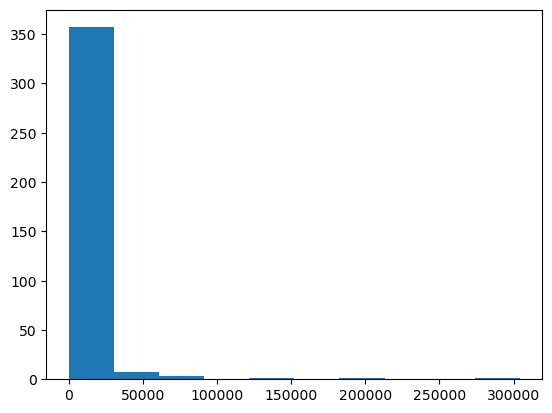

ipdb>  plt.hist(cell_gene_array.sum(axis = 1))


(array([2.642e+03, 4.180e+03, 1.831e+03, 4.110e+02, 8.800e+01, 3.700e+01,
       7.000e+00, 5.000e+00, 5.000e+00, 1.000e+00]), array([  6. , 100.6, 195.2, 289.8, 384.4, 479. , 573.6, 668.2, 762.8,
       857.4, 952. ]), <BarContainer object of 10 artists>)


ipdb>  plt.show()


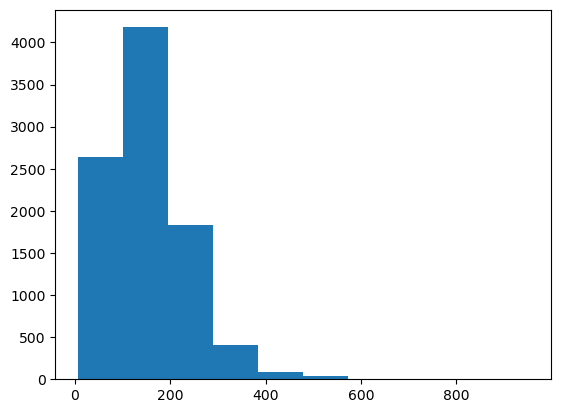

ipdb>  cell_type_mask


array([ True,  True,  True, ...,  True,  True,  True])


ipdb>  cell_type_mask.shape


(9207,)


ipdb>  nonzero_mask = cell_type_mask != 0
ipdb>  nonzero_mask


array([ True,  True,  True, ...,  True,  True,  True])


ipdb>  pp nonzero_mask.sum()


9207


ipdb>  pp cell_gene_array.shape


(9207, 370)


ipdb>  pp cell_gene_array


array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 1, ..., 0, 0, 0]])


ipdb>  nonzero_mask = cell_gene_array != 0
ipdb>  pp nonzero_mask.shape


(9207, 370)


ipdb>  pp nonzero_mask


array([[False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       ...,
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False,  True, ..., False, False, False]])


ipdb>  pp nonzero_mask.sum(axis = 0)


array([   0,   95,  336,  238,    2, 2576, 1214,  861,  617,   21,   46,
          0,    2,  176,    0,    1,  669,    2,   56,    1,  383,  126,
          6,    0,   56,  434,  676,   14,   20,    0,  278,   70,  237,
        199,    0,  770,    7,   11,  319, 3731,    0,    0,    0,    3,
        316,  174,   31,    9,   10,  311, 7478,   88,  103,   78,  784,
        621,  377,   17,    1,   30,   14, 5945, 7090,  920,  109,  225,
        145,   56, 1270, 3663,  252,    0,  399, 6992,  185,  149, 1759,
         46, 1355,  177,  116,   33,  374,   26,   41,    1,    0,    0,
          0,    0,   79,   37,   31,   70,   13,    2,   56,    4,  235,
          3,  129,    6,   30,   55,  181, 2732,   14,  270,   96,  588,
        119,  171,  424,    7,   45, 5468,   63,  669,    1,    0,   32,
          0,    4, 5158,  160,   23,   72,   21,   42,    0,  298,  808,
       5836,   48,   32,    4,  120,   32,    0,    0,   27,  133,   15,
         23,  670,  190,  301,   76,   46, 4615,  1

ipdb>  cells_nonzero_counts = nonzero_mask.sum()
ipdb>  pp cells_nonzero_counts.shape


()


ipdb>  pp cells_nonzero_counts


233910


ipdb>  nonzero_mask = cell_type_mask != 0
ipdb>  pp nonzero_mask.shape


(9207,)


ipdb>  pp nonzero_mask


array([ True,  True,  True, ...,  True,  True,  True])


ipdb>  pp cells_nonzero_counts = nonzero_mask.sum()


*** SyntaxError: invalid syntax


ipdb>  cells_nonzero_counts = nonzero_mask.sum()
ipdb>  pp cells_nonzero_counts


9207


ipdb>  cells_nonzero_counts


9207


ipdb>  pp nonzero_mask


array([ True,  True,  True, ...,  True,  True,  True])


ipdb>  pp nonzero_mask.shape


(9207,)


ipdb>  wuit


*** NameError: name 'wuit' is not defined


ipdb>  quit


In [52]:
%debug

In [81]:
amp2_ref_subset_reordered_no_nk_no_myeloid = amp2_ref_subset_reordered.iloc[~amp2_ref_subset_reordered.index.isin(['myeloid', 'NK']), :]

In [82]:
amp2_ref_subset_reordered_no_nk_no_myeloid.shape

(228632, 427)

In [100]:
amp2_ref_subset_reordered_myeloid= amp2_ref_subset_reordered.iloc[amp2_ref_subset_reordered.index.isin(['myeloid']), :]

In [101]:
amp2_ref_subset_reordered_myeloid.shape

(76171, 427)

In [103]:
# Create an empty list to store each of the arrays (this array is of shape num_ref_type x gene-gene pairs in nuc2seg type)
reference_corr_arrays_myeloid = []
for i in np.arange(10): # this iterates through the different cell-types in Xenium data:
    reference_corr_arrays_myeloid.append(calculate_corr_by_nuc2seg_celltype(gene_names_nonzero_celltype[i], amp2_ref_subset_reordered_myeloid, np.array(amp2_ref_subset_reordered_myeloid)))


ref_type: myeloid
cell_gene_array.shape: (76171, 370)
res.statistic: nan


/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_py.py:4921: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(warn_msg))


TypeError: 'float' object is not subscriptable

In [84]:
# Create an empty list to store each of the arrays (this array is of shape num_ref_type x gene-gene pairs in nuc2seg type)
reference_corr_arrays_per_nuc2seg_type_4 = []
for i in np.arange(10): # this iterates through the different cell-types in Xenium data:
    reference_corr_arrays_per_nuc2seg_type_4.append(calculate_corr_by_nuc2seg_celltype(gene_names_nonzero_celltype[i], amp2_ref_subset_reordered_no_nk_no_myeloid, np.array(amp2_ref_subset_reordered_no_nk_no_myeloid)))


ref_type: Bcell
cell_gene_array.shape: (30691, 370)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.         -0.0010473  -0.00138535 ... -0.00171531 -0.00113507
   0.01805991]
 [-0.0010473   1.          0.01777558 ...  0.03417851  0.04586152
   0.03340846]
 [-0.00138535  0.01777558  1.         ...  0.00314936  0.02275535
   0.01009753]
 ...
 [-0.00171531  0.03417851  0.00314936 ...  1.          0.02942666
   0.09679766]
 [-0.00113507  0.04586152  0.02275535 ...  0.02942666  1.
   0.03116564]
 [ 0.01805991  0.03340846  0.01009753 ...  0.09679766  0.03116564
   1.        ]]
(68265,)
ref_type: Endothelial
cell_gene_array.shape: (25044, 370)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.00000000e+00 -8.46714037e-03 -3.54053447e-03 ... -2.78532125e-03
  -7.27893633e-03 -6.04353802e-04]
 [-8.46714037e-03  1.00000000e+00  7.51985808e-02 ...  1.21125390e-01
   4.52686292e-01 -1.03009620e-01]
 [-3.54053447e-03  7.51985808e-02  1.00000000e+00 ...  5.01227879e-02
   1.59567086e-01  8.78647054e-02]
 ...
 [-2.78532125e-03  1.21125390e-01  5.01227879e-02 ...  1.00000000e+00
   1.23796657e-01 -8.34625126e-03]
 [-7.27893633e-03  4.52686292e-01  1.59567086e-01 ...  1.23796657e-01
   1.00000000e+00 -1.30260440e-02]
 [-6.04353802e-04 -1.03009620e-01  8.78647054e-02 ... -8.34625126e-03
  -1.30260440e-02  1.00000000e+00]]
(68265,)
ref_type: Fibroblast
cell_gene_array.shape: (79555, 370)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.         -0.00244217 -0.00492689 ... -0.00187198 -0.00222978
  -0.00183885]
 [-0.00244217  1.          0.06771284 ...  0.02166637  0.06764378
   0.0166047 ]
 [-0.00492689  0.06771284  1.         ...  0.02657102  0.03711406
   0.00811721]
 ...
 [-0.00187198  0.02166637  0.02657102 ...  1.          0.01374701
   0.01331659]
 [-0.00222978  0.06764378  0.03711406 ...  0.01374701  1.
   0.00233305]
 [-0.00183885  0.0166047   0.00811721 ...  0.01331659  0.00233305
   1.        ]]
(68265,)
ref_type: T cell
cell_gene_array.shape: (93342, 370)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.00000000e+00 -3.50128044e-04 -5.43093404e-04 ... -4.96680960e-04
  -3.74473967e-04 -6.94460580e-05]
 [-3.50128044e-04  1.00000000e+00  4.21897246e-03 ... -1.21205000e-03
   3.00389998e-02  1.20544207e-02]
 [-5.43093404e-04  4.21897246e-03  1.00000000e+00 ... -5.00866592e-03
   3.85975215e-04  2.73062017e-03]
 ...
 [-4.96680960e-04 -1.21205000e-03 -5.00866592e-03 ...  1.00000000e+00
   7.55750718e-03 -3.21956768e-03]
 [-3.74473967e-04  3.00389998e-02  3.85975215e-04 ...  7.55750718e-03
   1.00000000e+00 -2.42740185e-03]
 [-6.94460580e-05  1.20544207e-02  2.73062017e-03 ... -3.21956768e-03
  -2.42740185e-03  1.00000000e+00]]
(68265,)
ref_type: Bcell
cell_gene_array.shape: (30691, 307)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.         -0.0010473  -0.00138535 ... -0.00171531 -0.00113507
   0.01805991]
 [-0.0010473   1.          0.01777558 ...  0.03417851  0.04586152
   0.03340846]
 [-0.00138535  0.01777558  1.         ...  0.00314936  0.02275535
   0.01009753]
 ...
 [-0.00171531  0.03417851  0.00314936 ...  1.          0.02942666
   0.09679766]
 [-0.00113507  0.04586152  0.02275535 ...  0.02942666  1.
   0.03116564]
 [ 0.01805991  0.03340846  0.01009753 ...  0.09679766  0.03116564
   1.        ]]
(46971,)
ref_type: Endothelial
cell_gene_array.shape: (25044, 307)
res.statistic: [[ 1.00000000e+00 -8.46714037e-03 -3.54053447e-03 ... -2.78532125e-03
  -7.27893633e-03 -6.04353802e-04]
 [-8.46714037e-03  1.00000000e+00  7.51985808e-02 ...  1.21125390e-01
   4.52686292e-01 -1.03009620e-01]
 [-3.54053447e-03  7.51985808e-02  1.00000000e+00 ...  5.01227879e-02
   1.59567086e-01  8.78647054e-02]
 ...
 [-2.78532125e-03  1.21125390e-01  5.01227879e-02 ...  1.00000000e+00
   1.23796657e-01 -8.34625126

/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


ref_type: Fibroblast
cell_gene_array.shape: (79555, 307)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.         -0.00244217 -0.00492689 ... -0.00187198 -0.00222978
  -0.00183885]
 [-0.00244217  1.          0.06771284 ...  0.02166637  0.06764378
   0.0166047 ]
 [-0.00492689  0.06771284  1.         ...  0.02657102  0.03711406
   0.00811721]
 ...
 [-0.00187198  0.02166637  0.02657102 ...  1.          0.01374701
   0.01331659]
 [-0.00222978  0.06764378  0.03711406 ...  0.01374701  1.
   0.00233305]
 [-0.00183885  0.0166047   0.00811721 ...  0.01331659  0.00233305
   1.        ]]
(46971,)
ref_type: T cell
cell_gene_array.shape: (93342, 307)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.00000000e+00 -3.50128044e-04 -5.43093404e-04 ... -4.96680960e-04
  -3.74473967e-04 -6.94460580e-05]
 [-3.50128044e-04  1.00000000e+00  4.21897246e-03 ... -1.21205000e-03
   3.00389998e-02  1.20544207e-02]
 [-5.43093404e-04  4.21897246e-03  1.00000000e+00 ... -5.00866592e-03
   3.85975215e-04  2.73062017e-03]
 ...
 [-4.96680960e-04 -1.21205000e-03 -5.00866592e-03 ...  1.00000000e+00
   7.55750718e-03 -3.21956768e-03]
 [-3.74473967e-04  3.00389998e-02  3.85975215e-04 ...  7.55750718e-03
   1.00000000e+00 -2.42740185e-03]
 [-6.94460580e-05  1.20544207e-02  2.73062017e-03 ... -3.21956768e-03
  -2.42740185e-03  1.00000000e+00]]
(46971,)
ref_type: Bcell
cell_gene_array.shape: (30691, 309)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.00000000e+00  1.77755846e-02  6.93486826e-06 ...  3.41785135e-02
   4.58615189e-02  3.34084644e-02]
 [ 1.77755846e-02  1.00000000e+00 -1.30631066e-03 ...  3.14936313e-03
   2.27553510e-02  1.00975274e-02]
 [ 6.93486826e-06 -1.30631066e-03  1.00000000e+00 ...  1.88894690e-02
  -4.69878911e-03  5.03238118e-03]
 ...
 [ 3.41785135e-02  3.14936313e-03  1.88894690e-02 ...  1.00000000e+00
   2.94266632e-02  9.67976564e-02]
 [ 4.58615189e-02  2.27553510e-02 -4.69878911e-03 ...  2.94266632e-02
   1.00000000e+00  3.11656421e-02]
 [ 3.34084644e-02  1.00975274e-02  5.03238118e-03 ...  9.67976564e-02
   3.11656421e-02  1.00000000e+00]]
(47586,)
ref_type: Endothelial
cell_gene_array.shape: (25044, 309)
res.statistic: [[ 1.          0.07519858 -0.00541477 ...  0.12112539  0.45268629
  -0.10300962]
 [ 0.07519858  1.          0.02187567 ...  0.05012279  0.15956709
   0.08786471]
 [-0.00541477  0.02187567  1.         ...  0.02343246  0.05063526
   0.00536029]
 ...
 [ 0.12112539  0.05

/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


ref_type: Fibroblast
cell_gene_array.shape: (79555, 309)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.          0.06771284  0.00959269 ...  0.02166637  0.06764378
   0.0166047 ]
 [ 0.06771284  1.         -0.04344503 ...  0.02657102  0.03711406
   0.00811721]
 [ 0.00959269 -0.04344503  1.         ...  0.01729381 -0.00195837
   0.04793252]
 ...
 [ 0.02166637  0.02657102  0.01729381 ...  1.          0.01374701
   0.01331659]
 [ 0.06764378  0.03711406 -0.00195837 ...  0.01374701  1.
   0.00233305]
 [ 0.0166047   0.00811721  0.04793252 ...  0.01331659  0.00233305
   1.        ]]
(47586,)
ref_type: T cell
cell_gene_array.shape: (93342, 309)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.00000000e+00  4.21897246e-03  2.77510514e-03 ... -1.21205000e-03
   3.00389998e-02  1.20544207e-02]
 [ 4.21897246e-03  1.00000000e+00  5.36073268e-03 ... -5.00866592e-03
   3.85975215e-04  2.73062017e-03]
 [ 2.77510514e-03  5.36073268e-03  1.00000000e+00 ...  2.22700325e-02
   4.13940275e-03 -1.55367918e-04]
 ...
 [-1.21205000e-03 -5.00866592e-03  2.22700325e-02 ...  1.00000000e+00
   7.55750718e-03 -3.21956768e-03]
 [ 3.00389998e-02  3.85975215e-04  4.13940275e-03 ...  7.55750718e-03
   1.00000000e+00 -2.42740185e-03]
 [ 1.20544207e-02  2.73062017e-03 -1.55367918e-04 ... -3.21956768e-03
  -2.42740185e-03  1.00000000e+00]]
(47586,)
ref_type: Bcell
cell_gene_array.shape: (30691, 121)
res.statistic: [[ 1.         -0.00433902  0.00108494 ...  0.0085292   0.00597047
   0.0150024 ]
 [-0.00433902  1.          0.07403409 ...  0.07012845  0.00576296
   0.04220356]
 [ 0.00108494  0.07403409  1.         ...  0.05176853  0.00849493
   0.02822405]
 ...
 [ 0.0085292   0.07012845

/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.         -0.0010473  -0.00138535 ... -0.00171531 -0.00113507
   0.01805991]
 [-0.0010473   1.          0.01777558 ...  0.03417851  0.04586152
   0.03340846]
 [-0.00138535  0.01777558  1.         ...  0.00314936  0.02275535
   0.01009753]
 ...
 [-0.00171531  0.03417851  0.00314936 ...  1.          0.02942666
   0.09679766]
 [-0.00113507  0.04586152  0.02275535 ...  0.02942666  1.
   0.03116564]
 [ 0.01805991  0.03340846  0.01009753 ...  0.09679766  0.03116564
   1.        ]]
(82621,)
ref_type: Endothelial
cell_gene_array.shape: (25044, 407)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.00000000e+00 -8.46714037e-03 -3.54053447e-03 ... -2.78532125e-03
  -7.27893633e-03 -6.04353802e-04]
 [-8.46714037e-03  1.00000000e+00  7.51985808e-02 ...  1.21125390e-01
   4.52686292e-01 -1.03009620e-01]
 [-3.54053447e-03  7.51985808e-02  1.00000000e+00 ...  5.01227879e-02
   1.59567086e-01  8.78647054e-02]
 ...
 [-2.78532125e-03  1.21125390e-01  5.01227879e-02 ...  1.00000000e+00
   1.23796657e-01 -8.34625126e-03]
 [-7.27893633e-03  4.52686292e-01  1.59567086e-01 ...  1.23796657e-01
   1.00000000e+00 -1.30260440e-02]
 [-6.04353802e-04 -1.03009620e-01  8.78647054e-02 ... -8.34625126e-03
  -1.30260440e-02  1.00000000e+00]]
(82621,)
ref_type: Fibroblast
cell_gene_array.shape: (79555, 407)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.         -0.00244217 -0.00492689 ... -0.00187198 -0.00222978
  -0.00183885]
 [-0.00244217  1.          0.06771284 ...  0.02166637  0.06764378
   0.0166047 ]
 [-0.00492689  0.06771284  1.         ...  0.02657102  0.03711406
   0.00811721]
 ...
 [-0.00187198  0.02166637  0.02657102 ...  1.          0.01374701
   0.01331659]
 [-0.00222978  0.06764378  0.03711406 ...  0.01374701  1.
   0.00233305]
 [-0.00183885  0.0166047   0.00811721 ...  0.01331659  0.00233305
   1.        ]]
(82621,)
ref_type: T cell
cell_gene_array.shape: (93342, 407)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.00000000e+00 -3.50128044e-04 -5.43093404e-04 ... -4.96680960e-04
  -3.74473967e-04 -6.94460580e-05]
 [-3.50128044e-04  1.00000000e+00  4.21897246e-03 ... -1.21205000e-03
   3.00389998e-02  1.20544207e-02]
 [-5.43093404e-04  4.21897246e-03  1.00000000e+00 ... -5.00866592e-03
   3.85975215e-04  2.73062017e-03]
 ...
 [-4.96680960e-04 -1.21205000e-03 -5.00866592e-03 ...  1.00000000e+00
   7.55750718e-03 -3.21956768e-03]
 [-3.74473967e-04  3.00389998e-02  3.85975215e-04 ...  7.55750718e-03
   1.00000000e+00 -2.42740185e-03]
 [-6.94460580e-05  1.20544207e-02  2.73062017e-03 ... -3.21956768e-03
  -2.42740185e-03  1.00000000e+00]]
(82621,)
ref_type: Bcell
cell_gene_array.shape: (30691, 344)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.         -0.0010473  -0.00138535 ... -0.00171531 -0.00113507
   0.01805991]
 [-0.0010473   1.          0.01777558 ...  0.03417851  0.04586152
   0.03340846]
 [-0.00138535  0.01777558  1.         ...  0.00314936  0.02275535
   0.01009753]
 ...
 [-0.00171531  0.03417851  0.00314936 ...  1.          0.02942666
   0.09679766]
 [-0.00113507  0.04586152  0.02275535 ...  0.02942666  1.
   0.03116564]
 [ 0.01805991  0.03340846  0.01009753 ...  0.09679766  0.03116564
   1.        ]]
(58996,)
ref_type: Endothelial
cell_gene_array.shape: (25044, 344)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.00000000e+00 -8.46714037e-03 -3.54053447e-03 ... -2.78532125e-03
  -7.27893633e-03 -6.04353802e-04]
 [-8.46714037e-03  1.00000000e+00  7.51985808e-02 ...  1.21125390e-01
   4.52686292e-01 -1.03009620e-01]
 [-3.54053447e-03  7.51985808e-02  1.00000000e+00 ...  5.01227879e-02
   1.59567086e-01  8.78647054e-02]
 ...
 [-2.78532125e-03  1.21125390e-01  5.01227879e-02 ...  1.00000000e+00
   1.23796657e-01 -8.34625126e-03]
 [-7.27893633e-03  4.52686292e-01  1.59567086e-01 ...  1.23796657e-01
   1.00000000e+00 -1.30260440e-02]
 [-6.04353802e-04 -1.03009620e-01  8.78647054e-02 ... -8.34625126e-03
  -1.30260440e-02  1.00000000e+00]]
(58996,)
ref_type: Fibroblast
cell_gene_array.shape: (79555, 344)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.         -0.00244217 -0.00492689 ... -0.00187198 -0.00222978
  -0.00183885]
 [-0.00244217  1.          0.06771284 ...  0.02166637  0.06764378
   0.0166047 ]
 [-0.00492689  0.06771284  1.         ...  0.02657102  0.03711406
   0.00811721]
 ...
 [-0.00187198  0.02166637  0.02657102 ...  1.          0.01374701
   0.01331659]
 [-0.00222978  0.06764378  0.03711406 ...  0.01374701  1.
   0.00233305]
 [-0.00183885  0.0166047   0.00811721 ...  0.01331659  0.00233305
   1.        ]]
(58996,)
ref_type: T cell
cell_gene_array.shape: (93342, 344)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.00000000e+00 -3.50128044e-04 -5.43093404e-04 ... -4.96680960e-04
  -3.74473967e-04 -6.94460580e-05]
 [-3.50128044e-04  1.00000000e+00  4.21897246e-03 ... -1.21205000e-03
   3.00389998e-02  1.20544207e-02]
 [-5.43093404e-04  4.21897246e-03  1.00000000e+00 ... -5.00866592e-03
   3.85975215e-04  2.73062017e-03]
 ...
 [-4.96680960e-04 -1.21205000e-03 -5.00866592e-03 ...  1.00000000e+00
   7.55750718e-03 -3.21956768e-03]
 [-3.74473967e-04  3.00389998e-02  3.85975215e-04 ...  7.55750718e-03
   1.00000000e+00 -2.42740185e-03]
 [-6.94460580e-05  1.20544207e-02  2.73062017e-03 ... -3.21956768e-03
  -2.42740185e-03  1.00000000e+00]]
(58996,)
ref_type: Bcell
cell_gene_array.shape: (30691, 380)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.         -0.0010473  -0.00138535 ... -0.00171531 -0.00113507
   0.01805991]
 [-0.0010473   1.          0.01777558 ...  0.03417851  0.04586152
   0.03340846]
 [-0.00138535  0.01777558  1.         ...  0.00314936  0.02275535
   0.01009753]
 ...
 [-0.00171531  0.03417851  0.00314936 ...  1.          0.02942666
   0.09679766]
 [-0.00113507  0.04586152  0.02275535 ...  0.02942666  1.
   0.03116564]
 [ 0.01805991  0.03340846  0.01009753 ...  0.09679766  0.03116564
   1.        ]]
(72010,)
ref_type: Endothelial
cell_gene_array.shape: (25044, 380)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.00000000e+00 -8.46714037e-03 -3.54053447e-03 ... -2.78532125e-03
  -7.27893633e-03 -6.04353802e-04]
 [-8.46714037e-03  1.00000000e+00  7.51985808e-02 ...  1.21125390e-01
   4.52686292e-01 -1.03009620e-01]
 [-3.54053447e-03  7.51985808e-02  1.00000000e+00 ...  5.01227879e-02
   1.59567086e-01  8.78647054e-02]
 ...
 [-2.78532125e-03  1.21125390e-01  5.01227879e-02 ...  1.00000000e+00
   1.23796657e-01 -8.34625126e-03]
 [-7.27893633e-03  4.52686292e-01  1.59567086e-01 ...  1.23796657e-01
   1.00000000e+00 -1.30260440e-02]
 [-6.04353802e-04 -1.03009620e-01  8.78647054e-02 ... -8.34625126e-03
  -1.30260440e-02  1.00000000e+00]]
(72010,)
ref_type: Fibroblast
cell_gene_array.shape: (79555, 380)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.         -0.00244217 -0.00492689 ... -0.00187198 -0.00222978
  -0.00183885]
 [-0.00244217  1.          0.06771284 ...  0.02166637  0.06764378
   0.0166047 ]
 [-0.00492689  0.06771284  1.         ...  0.02657102  0.03711406
   0.00811721]
 ...
 [-0.00187198  0.02166637  0.02657102 ...  1.          0.01374701
   0.01331659]
 [-0.00222978  0.06764378  0.03711406 ...  0.01374701  1.
   0.00233305]
 [-0.00183885  0.0166047   0.00811721 ...  0.01331659  0.00233305
   1.        ]]
(72010,)
ref_type: T cell
cell_gene_array.shape: (93342, 380)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.00000000e+00 -3.50128044e-04 -5.43093404e-04 ... -4.96680960e-04
  -3.74473967e-04 -6.94460580e-05]
 [-3.50128044e-04  1.00000000e+00  4.21897246e-03 ... -1.21205000e-03
   3.00389998e-02  1.20544207e-02]
 [-5.43093404e-04  4.21897246e-03  1.00000000e+00 ... -5.00866592e-03
   3.85975215e-04  2.73062017e-03]
 ...
 [-4.96680960e-04 -1.21205000e-03 -5.00866592e-03 ...  1.00000000e+00
   7.55750718e-03 -3.21956768e-03]
 [-3.74473967e-04  3.00389998e-02  3.85975215e-04 ...  7.55750718e-03
   1.00000000e+00 -2.42740185e-03]
 [-6.94460580e-05  1.20544207e-02  2.73062017e-03 ... -3.21956768e-03
  -2.42740185e-03  1.00000000e+00]]
(72010,)
ref_type: Bcell
cell_gene_array.shape: (30691, 413)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.         -0.0010473  -0.00138535 ... -0.00171531 -0.00113507
   0.01805991]
 [-0.0010473   1.          0.01777558 ...  0.03417851  0.04586152
   0.03340846]
 [-0.00138535  0.01777558  1.         ...  0.00314936  0.02275535
   0.01009753]
 ...
 [-0.00171531  0.03417851  0.00314936 ...  1.          0.02942666
   0.09679766]
 [-0.00113507  0.04586152  0.02275535 ...  0.02942666  1.
   0.03116564]
 [ 0.01805991  0.03340846  0.01009753 ...  0.09679766  0.03116564
   1.        ]]
(85078,)
ref_type: Endothelial
cell_gene_array.shape: (25044, 413)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.00000000e+00 -8.46714037e-03 -3.54053447e-03 ... -2.78532125e-03
  -7.27893633e-03 -6.04353802e-04]
 [-8.46714037e-03  1.00000000e+00  7.51985808e-02 ...  1.21125390e-01
   4.52686292e-01 -1.03009620e-01]
 [-3.54053447e-03  7.51985808e-02  1.00000000e+00 ...  5.01227879e-02
   1.59567086e-01  8.78647054e-02]
 ...
 [-2.78532125e-03  1.21125390e-01  5.01227879e-02 ...  1.00000000e+00
   1.23796657e-01 -8.34625126e-03]
 [-7.27893633e-03  4.52686292e-01  1.59567086e-01 ...  1.23796657e-01
   1.00000000e+00 -1.30260440e-02]
 [-6.04353802e-04 -1.03009620e-01  8.78647054e-02 ... -8.34625126e-03
  -1.30260440e-02  1.00000000e+00]]
(85078,)
ref_type: Fibroblast
cell_gene_array.shape: (79555, 413)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.         -0.00244217 -0.00492689 ... -0.00187198 -0.00222978
  -0.00183885]
 [-0.00244217  1.          0.06771284 ...  0.02166637  0.06764378
   0.0166047 ]
 [-0.00492689  0.06771284  1.         ...  0.02657102  0.03711406
   0.00811721]
 ...
 [-0.00187198  0.02166637  0.02657102 ...  1.          0.01374701
   0.01331659]
 [-0.00222978  0.06764378  0.03711406 ...  0.01374701  1.
   0.00233305]
 [-0.00183885  0.0166047   0.00811721 ...  0.01331659  0.00233305
   1.        ]]
(85078,)
ref_type: T cell
cell_gene_array.shape: (93342, 413)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.00000000e+00 -3.50128044e-04 -5.43093404e-04 ... -4.96680960e-04
  -3.74473967e-04 -6.94460580e-05]
 [-3.50128044e-04  1.00000000e+00  4.21897246e-03 ... -1.21205000e-03
   3.00389998e-02  1.20544207e-02]
 [-5.43093404e-04  4.21897246e-03  1.00000000e+00 ... -5.00866592e-03
   3.85975215e-04  2.73062017e-03]
 ...
 [-4.96680960e-04 -1.21205000e-03 -5.00866592e-03 ...  1.00000000e+00
   7.55750718e-03 -3.21956768e-03]
 [-3.74473967e-04  3.00389998e-02  3.85975215e-04 ...  7.55750718e-03
   1.00000000e+00 -2.42740185e-03]
 [-6.94460580e-05  1.20544207e-02  2.73062017e-03 ... -3.21956768e-03
  -2.42740185e-03  1.00000000e+00]]
(85078,)
ref_type: Bcell
cell_gene_array.shape: (30691, 372)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.         -0.0010473  -0.00138535 ... -0.00171531 -0.00113507
   0.01805991]
 [-0.0010473   1.          0.01777558 ...  0.03417851  0.04586152
   0.03340846]
 [-0.00138535  0.01777558  1.         ...  0.00314936  0.02275535
   0.01009753]
 ...
 [-0.00171531  0.03417851  0.00314936 ...  1.          0.02942666
   0.09679766]
 [-0.00113507  0.04586152  0.02275535 ...  0.02942666  1.
   0.03116564]
 [ 0.01805991  0.03340846  0.01009753 ...  0.09679766  0.03116564
   1.        ]]
(69006,)
ref_type: Endothelial
cell_gene_array.shape: (25044, 372)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.00000000e+00 -8.46714037e-03 -3.54053447e-03 ... -2.78532125e-03
  -7.27893633e-03 -6.04353802e-04]
 [-8.46714037e-03  1.00000000e+00  7.51985808e-02 ...  1.21125390e-01
   4.52686292e-01 -1.03009620e-01]
 [-3.54053447e-03  7.51985808e-02  1.00000000e+00 ...  5.01227879e-02
   1.59567086e-01  8.78647054e-02]
 ...
 [-2.78532125e-03  1.21125390e-01  5.01227879e-02 ...  1.00000000e+00
   1.23796657e-01 -8.34625126e-03]
 [-7.27893633e-03  4.52686292e-01  1.59567086e-01 ...  1.23796657e-01
   1.00000000e+00 -1.30260440e-02]
 [-6.04353802e-04 -1.03009620e-01  8.78647054e-02 ... -8.34625126e-03
  -1.30260440e-02  1.00000000e+00]]
(69006,)
ref_type: Fibroblast
cell_gene_array.shape: (79555, 372)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.         -0.00244217 -0.00492689 ... -0.00187198 -0.00222978
  -0.00183885]
 [-0.00244217  1.          0.06771284 ...  0.02166637  0.06764378
   0.0166047 ]
 [-0.00492689  0.06771284  1.         ...  0.02657102  0.03711406
   0.00811721]
 ...
 [-0.00187198  0.02166637  0.02657102 ...  1.          0.01374701
   0.01331659]
 [-0.00222978  0.06764378  0.03711406 ...  0.01374701  1.
   0.00233305]
 [-0.00183885  0.0166047   0.00811721 ...  0.01331659  0.00233305
   1.        ]]
(69006,)
ref_type: T cell
cell_gene_array.shape: (93342, 372)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.00000000e+00 -3.50128044e-04 -5.43093404e-04 ... -4.96680960e-04
  -3.74473967e-04 -6.94460580e-05]
 [-3.50128044e-04  1.00000000e+00  4.21897246e-03 ... -1.21205000e-03
   3.00389998e-02  1.20544207e-02]
 [-5.43093404e-04  4.21897246e-03  1.00000000e+00 ... -5.00866592e-03
   3.85975215e-04  2.73062017e-03]
 ...
 [-4.96680960e-04 -1.21205000e-03 -5.00866592e-03 ...  1.00000000e+00
   7.55750718e-03 -3.21956768e-03]
 [-3.74473967e-04  3.00389998e-02  3.85975215e-04 ...  7.55750718e-03
   1.00000000e+00 -2.42740185e-03]
 [-6.94460580e-05  1.20544207e-02  2.73062017e-03 ... -3.21956768e-03
  -2.42740185e-03  1.00000000e+00]]
(69006,)
ref_type: Bcell
cell_gene_array.shape: (30691, 392)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.         -0.0010473  -0.00138535 ... -0.00171531 -0.00113507
   0.01805991]
 [-0.0010473   1.          0.01777558 ...  0.03417851  0.04586152
   0.03340846]
 [-0.00138535  0.01777558  1.         ...  0.00314936  0.02275535
   0.01009753]
 ...
 [-0.00171531  0.03417851  0.00314936 ...  1.          0.02942666
   0.09679766]
 [-0.00113507  0.04586152  0.02275535 ...  0.02942666  1.
   0.03116564]
 [ 0.01805991  0.03340846  0.01009753 ...  0.09679766  0.03116564
   1.        ]]
(76636,)
ref_type: Endothelial
cell_gene_array.shape: (25044, 392)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.00000000e+00 -8.46714037e-03 -3.54053447e-03 ... -2.78532125e-03
  -7.27893633e-03 -6.04353802e-04]
 [-8.46714037e-03  1.00000000e+00  7.51985808e-02 ...  1.21125390e-01
   4.52686292e-01 -1.03009620e-01]
 [-3.54053447e-03  7.51985808e-02  1.00000000e+00 ...  5.01227879e-02
   1.59567086e-01  8.78647054e-02]
 ...
 [-2.78532125e-03  1.21125390e-01  5.01227879e-02 ...  1.00000000e+00
   1.23796657e-01 -8.34625126e-03]
 [-7.27893633e-03  4.52686292e-01  1.59567086e-01 ...  1.23796657e-01
   1.00000000e+00 -1.30260440e-02]
 [-6.04353802e-04 -1.03009620e-01  8.78647054e-02 ... -8.34625126e-03
  -1.30260440e-02  1.00000000e+00]]
(76636,)
ref_type: Fibroblast
cell_gene_array.shape: (79555, 392)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.         -0.00244217 -0.00492689 ... -0.00187198 -0.00222978
  -0.00183885]
 [-0.00244217  1.          0.06771284 ...  0.02166637  0.06764378
   0.0166047 ]
 [-0.00492689  0.06771284  1.         ...  0.02657102  0.03711406
   0.00811721]
 ...
 [-0.00187198  0.02166637  0.02657102 ...  1.          0.01374701
   0.01331659]
 [-0.00222978  0.06764378  0.03711406 ...  0.01374701  1.
   0.00233305]
 [-0.00183885  0.0166047   0.00811721 ...  0.01331659  0.00233305
   1.        ]]
(76636,)
ref_type: T cell
cell_gene_array.shape: (93342, 392)
res.statistic: [[ 1.00000000e+00 -3.50128044e-04 -5.43093404e-04 ... -4.96680960e-04
  -3.74473967e-04 -6.94460580e-05]
 [-3.50128044e-04  1.00000000e+00  4.21897246e-03 ... -1.21205000e-03
   3.00389998e-02  1.20544207e-02]
 [-5.43093404e-04  4.21897246e-03  1.00000000e+00 ... -5.00866592e-03
   3.85975215e-04  2.73062017e-03]
 ...
 [-4.96680960e-04 -1.21205000e-03 -5.00866592e-03 ...  1.00000000e+00
   7.55750718e-03 -3.21956768e-03]

/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


In [87]:
# Stack the 1D numpy arrays within each sublist
stacked_arrays = [np.stack(sublist) for sublist in reference_corr_arrays_per_nuc2seg_type_4]

In [88]:
stacked_arrays

[array([[-0.0010473 , -0.00138535, -0.00120138, ...,  0.02942666,
          0.09679766,  0.03116564],
        [-0.00846714, -0.00354053, -0.00125398, ...,  0.12379666,
         -0.00834625, -0.01302604],
        [-0.00244217, -0.00492689,  0.00217184, ...,  0.01374701,
          0.01331659,  0.00233305],
        [-0.00035013, -0.00054309, -0.00075252, ...,  0.00755751,
         -0.00321957, -0.0024274 ]]),
 array([[-0.0010473 , -0.00138535, -0.00120138, ...,  0.02942666,
          0.09679766,  0.03116564],
        [-0.00846714, -0.00354053, -0.00125398, ...,  0.12379666,
         -0.00834625, -0.01302604],
        [-0.00244217, -0.00492689,  0.00217184, ...,  0.01374701,
          0.01331659,  0.00233305],
        [-0.00035013, -0.00054309, -0.00075252, ...,  0.00755751,
         -0.00321957, -0.0024274 ]]),
 array([[ 1.77755846e-02,  6.93486826e-06, -2.22191125e-03, ...,
          2.94266632e-02,  9.67976564e-02,  3.11656421e-02],
        [ 7.51985808e-02, -5.41476903e-03,  1.02223243

In [85]:
# Let's write a function for dropping NaNs in the corr_coeff_vector from the AMP reference data, and calculate cosine similarity    
def filter_nans_calculate_cosine_similarity(np_array_corr_coeff, xenium_corr_array):
    """
    np_array_corr_coeff: [ref_num_cell_types x gene_combos array] [6 x 45000]
    xenium_corr_array:   [1 x gene_combos_array]                  [1 x ] # correlations
    
    return: arrays of shape: [1 x ref_num_cell_types] with cosine similarity in each entry for xenium_cluster and all ref clusters
    """
    # Find where there are NaNs, and remove those columns from the matrix
    print(f'shape of np_array_corr_coeff: {np_array_corr_coeff.shape}')
    filter_nan_mask = np.isnan(np_array_corr_coeff.sum(axis = 0))
    print(f'Number of NaN gene_gene pairs: {np.sum(filter_nan_mask)}')
    filtered_corr_array = np_array_corr_coeff[:, ~filter_nan_mask]
    
    # Want to check if the above removed all NaNs 
    print(f'number of NaNs in ref dataset post-filtering: {np.isnan(filtered_corr_array).sum()}')
    
    # Create an empty cosine_similarity_array [num_cell_types_ref x filtered_amp array]
    cos_similarities = np.zeros((1, np_array_corr_coeff.shape[0]))
    # print(f'shape of cosine_similarity_array: {cos_similarities.shape}')
    
    for j, cluster_corr_coeff_reference in enumerate(filtered_corr_array): 
        # print(j)
        # print(cluster_corr_coeff_reference[None, :].shape)
        # Also remove the Spearman's correlation from Xenium - cluster vector for cosine similarity computation
        # print(f'gene_gene_pairs in xenium corr np array: {xenium_corr_array.shape[0]}')
        nuc2seg_corr = xenium_corr_array[0:np_array_corr_coeff.shape[1]].squeeze()[~filter_nan_mask]
        print(f'nuc2seg_filtered_corr_array shape: {nuc2seg_corr.shape} ')
        print(f'Number of NaNs in nuc2seg filtered corr array: {np.isnan(nuc2seg_corr).sum()}')
        cos_similarities[0, j] = cosine_similarity(nuc2seg_corr[None, :], cluster_corr_coeff_reference[None, :])
    return cos_similarities

In [139]:
final_corr_array = np.zeros((10, 4))
for xenium_cluster in np.arange(10):
    # for reference_cluster in np.arange(6):
    final_corr_array[xenium_cluster, :] = filter_nans_calculate_cosine_similarity(stacked_arrays[xenium_cluster], correlations_xenium[xenium_cluster])

shape of np_array_corr_coeff: (4, 68265)
Number of NaN gene_gene pairs: 9269
number of NaNs in ref dataset post-filtering: 0
nuc2seg_filtered_corr_array shape: (58996,) 
Number of NaNs in nuc2seg filtered corr array: 0
nuc2seg_filtered_corr_array shape: (58996,) 
Number of NaNs in nuc2seg filtered corr array: 0
nuc2seg_filtered_corr_array shape: (58996,) 
Number of NaNs in nuc2seg filtered corr array: 0
nuc2seg_filtered_corr_array shape: (58996,) 
Number of NaNs in nuc2seg filtered corr array: 0
shape of np_array_corr_coeff: (4, 46971)
Number of NaN gene_gene pairs: 2718
number of NaNs in ref dataset post-filtering: 0
nuc2seg_filtered_corr_array shape: (44253,) 
Number of NaNs in nuc2seg filtered corr array: 0
nuc2seg_filtered_corr_array shape: (44253,) 
Number of NaNs in nuc2seg filtered corr array: 0
nuc2seg_filtered_corr_array shape: (44253,) 
Number of NaNs in nuc2seg filtered corr array: 0
nuc2seg_filtered_corr_array shape: (44253,) 
Number of NaNs in nuc2seg filtered corr array: 

In [140]:
final_corr_array

array([[0.21987369, 0.19681341, 0.23902935, 0.28902099],
       [0.22664839, 0.2897114 , 0.474465  , 0.21110405],
       [0.20882599, 0.54462449, 0.2631458 , 0.15999113],
       [0.3146843 , 0.22979774, 0.26225664, 0.30057973],
       [0.23409798, 0.2216347 , 0.29279215, 0.35146337],
       [0.21482416, 0.36744882, 0.32239091, 0.20272928],
       [0.34646512, 0.203377  , 0.23640443, 0.23196617],
       [0.21814029, 0.2608221 , 0.45849759, 0.20624313],
       [0.22023154, 0.23968893, 0.31122746, 0.23058694],
       [0.23654753, 0.2412832 , 0.26886642, 0.2099478 ]])

In [94]:
np.unique(amp2_ref_subset_reordered_no_nk_no_myeloid.index)

array(['Bcell', 'Endothelial', 'Fibroblast', 'T cell'], dtype=object)

In [105]:
# Let's group Xenium cell-types based on the marker gene plots
s1_r1_df.index

CategoricalIndex([9, 9, 8, 8, 9, 8, 9, 9, 8, 9,
                  ...
                  4, 7, 0, 7, 8, 9, 8, 8, 1, 8],
                 categories=[0, 1, 2, 3, ..., 6, 7, 8, 9], ordered=True, dtype='category', name='celltype_assignment', length=59323)

In [111]:
# Dictionary mapping old labels to new labels
fine_to_high_level_mapping = {0: 0, 
                              1: 1, 
                              2: 2,
                              3: 3, 
                              4: 0,
                              5: 1, 
                              6: 4, 
                              7:1, 
                              8:5, 
                              9:5}

# Create a new column by mapping index labels to new labels
s1_r1_df['broad_celltype'] = s1_r1_df.index.map(fine_to_high_level_mapping)


In [112]:
s1_r1_df

,ABCC11,ACE2,ACKR1,ACKR3,ACTA2,ACTG2,ADAM10,ADAM17,ADAM28,ADAMTS1,...,UBE2C,UMOD,UPK3B,VCAN,VEGFA,VSIG4,VWA5A,VWF,WNT5A,broad_celltype
celltype_assignment,,,,,,,,,,,,,,,,,,,,,
9,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,5
9,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,5
8,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,5
8,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,5
9,0,0,0,0,0,0,5,0,2,1,...,0,0,0,2,0,2,0,0,0,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9,0,0,0,0,0,0,1,1,0,0,...,0,0,0,0,0,0,0,0,0,5
8,0,0,0,0,0,0,0,1,3,0,...,0,0,0,0,0,1,0,0,0,5
8,0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,1,0,0,0,5


In [118]:
s1_r1_df.loc[:, 'broad_celltype'] == np.unique(s1_r1_df.loc[:, 'broad_celltype'])[0]

celltype_assignment
9    False
9    False
8    False
8    False
9    False
     ...  
9    False
8    False
8    False
1    False
8    False
Name: broad_celltype, Length: 59323, dtype: bool

In [125]:
# Create a list of lists wherein the inner list is per cell-type for genes that we will use for calculating Spearman's coefficients
gene_names_nonzero_broader_celltype = [[] for _ in range(len(np.unique(s1_r1_df.loc[:, 'broad_celltype'])))]

for i in range(len(np.unique(s1_r1_df.loc[:, 'broad_celltype']))):
    print(i)
    cell_type_mask = s1_r1_df.loc[s1_r1_df.loc[:, 'broad_celltype'] == np.unique(s1_r1_df.loc[:, 'broad_celltype'])[i], :]
    print(cell_type_mask.shape)
    nonzero_mask = cell_type_mask.iloc[:, 0:427] != 0
    # print(nonzero_mask.shape)
    cells_nonzero_counts = nonzero_mask.sum()
    print(len(cells_nonzero_counts))
    # Get the column names (gene names) where the count of nonzero entries is at least 10
    genes_to_keep_broad = cells_nonzero_counts[cells_nonzero_counts >= 10].index.tolist()
    print(len(genes_to_keep_broad))
    gene_names_nonzero_broader_celltype[i] = genes_to_keep_broad

0
(14972, 428)
427
417
1
(19766, 428)
427
423
2
(2768, 428)
427
309
3
(479, 428)
427
121
4
(6995, 428)
427
380
5
(14343, 428)
427
416


In [129]:
gene_names_nonzero_broader_celltype[3]

['ACTG2',
 'ADAM10',
 'ADAM17',
 'AIF1',
 'ANPEP',
 'ASPN',
 'BASP1',
 'BCL2L11',
 'C1orf162',
 'CAVIN1',
 'CAVIN2',
 'CCL2',
 'CCL5',
 'CD14',
 'CD163',
 'CD274',
 'CD28',
 'CD3D',
 'CD3E',
 'CD4',
 'CD68',
 'CD69',
 'CD79A',
 'CD8A',
 'CD93',
 'CFB',
 'COL5A2',
 'CPA3',
 'CRISPLD2',
 'CTNNB1',
 'CTSG',
 'CTSK',
 'CXCL12',
 'CXCL16',
 'CXCR4',
 'CYTIP',
 'DPT',
 'DST',
 'EDNRB',
 'ERG',
 'FBLN1',
 'FBN1',
 'FCER1A',
 'FCGR1A',
 'FCGR3A',
 'FGL2',
 'FKBP11',
 'FZD1',
 'GATA2',
 'GEM',
 'GLI3',
 'GLIPR1',
 'GPR183',
 'GZMA',
 'GZMK',
 'HAVCR2',
 'HGF',
 'HIF1A',
 'HOXA10',
 'HOXA9',
 'HPGDS',
 'IGF1',
 'IL1RL1',
 'IL6',
 'IL6R',
 'IRF8',
 'ITGB8',
 'KCNMA1',
 'KIT',
 'LIF',
 'LILRB2',
 'LYVE1',
 'MARCO',
 'MDM2',
 'MEDAG',
 'MLPH',
 'MNDA',
 'MPEG1',
 'MRC1',
 'MS4A2',
 'MS4A4A',
 'MS4A6A',
 'MYC',
 'MZB1',
 'OGN',
 'PCNA',
 'PCOLCE',
 'PDGFRA',
 'PDGFRB',
 'PDPN',
 'PECAM1',
 'PLCG2',
 'PMP22',
 'PRDM1',
 'PRG4',
 'PTGDS',
 'PTN',
 'PTPRC',
 'RTKN2',
 'SERPINB9',
 'SFRP1',
 'SFRP2',
 '

In [130]:
# With these genes that are expressed in at least 10 cells per cell-type, let's calculate the Spearman correlation coeff b/w gene pairs
# Let's now do the combination of pairs of genes per each of these Xenium (nuc2seg) clusters

correlations_xenium_broad_celltypes = []

for i in range(len(np.unique(s1_r1_df.loc[:, 'broad_celltype']))):
    cell_type_mask = s1_r1_df.loc[:, 'broad_celltype'] == np.unique(s1_r1_df.loc[:, 'broad_celltype'])[i]
    cell_gene_df = s1_r1_df[cell_type_mask].loc[:, gene_names_nonzero_broader_celltype[i]]
    print(np.array(cell_gene_df).shape)
    res = scipy.stats.spearmanr(cell_gene_df)
    print(res.statistic[np.triu_indices(n = len(gene_names_nonzero_broader_celltype[i]), k = 1)].shape)
    length_of_corr = res.statistic[np.triu_indices(n = len(gene_names_nonzero_broader_celltype[i]), k = 1)].shape[0]
    correlations_xenium_broad_celltypes.append(res.statistic[np.triu_indices(n = len(gene_names_nonzero_broader_celltype[i]), k = 1)])

(14972, 417)
(86736,)
(19766, 423)
(89253,)
(2768, 309)
(47586,)
(479, 121)
(7260,)
(6995, 380)
(72010,)
(14343, 416)
(86320,)


In [131]:
correlations_xenium_broad_celltypes

[array([-0.00287718, -0.00597253, -0.0089454 , ..., -0.0110962 ,
         0.00441549,  0.01878132]),
 array([-0.00113968, -0.00237364,  0.00710388, ...,  0.00705713,
         0.02777241, -0.00338122]),
 array([0.0315813 , 0.14555986, 0.03315732, ..., 0.11470165, 0.00329529,
        0.03583376]),
 array([ 0.06944816,  0.01080316, -0.00821925, ...,  0.01976641,
         0.18047644,  0.0754737 ]),
 array([-0.00272004, -0.00741645, -0.00778458, ...,  0.01084877,
         0.01863014,  0.00639592]),
 array([ 0.01982399, -0.00215295,  0.00150953, ...,  0.0065032 ,
        -0.00595188, -0.00490905])]

In [133]:
# Create an empty list to store each of the arrays (this array is of shape num_ref_type x gene-gene pairs in nuc2seg type)
reference_corr_arrays_per_nuc2seg_type_broad = []
for i in np.arange(10): # this iterates through the different cell-types in Xenium data:
    reference_corr_arrays_per_nuc2seg_type_broad.append(calculate_corr_by_nuc2seg_celltype(gene_names_nonzero_broader_celltype[i], amp2_ref_subset_reordered_no_nk_no_myeloid, np.array(amp2_ref_subset_reordered_no_nk_no_myeloid)))


ref_type: Bcell
cell_gene_array.shape: (30691, 417)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.         -0.0010473  -0.00138535 ... -0.00171531 -0.00113507
   0.01805991]
 [-0.0010473   1.          0.01777558 ...  0.03417851  0.04586152
   0.03340846]
 [-0.00138535  0.01777558  1.         ...  0.00314936  0.02275535
   0.01009753]
 ...
 [-0.00171531  0.03417851  0.00314936 ...  1.          0.02942666
   0.09679766]
 [-0.00113507  0.04586152  0.02275535 ...  0.02942666  1.
   0.03116564]
 [ 0.01805991  0.03340846  0.01009753 ...  0.09679766  0.03116564
   1.        ]]
(86736,)
ref_type: Endothelial
cell_gene_array.shape: (25044, 417)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.00000000e+00 -8.46714037e-03 -3.54053447e-03 ... -2.78532125e-03
  -7.27893633e-03 -6.04353802e-04]
 [-8.46714037e-03  1.00000000e+00  7.51985808e-02 ...  1.21125390e-01
   4.52686292e-01 -1.03009620e-01]
 [-3.54053447e-03  7.51985808e-02  1.00000000e+00 ...  5.01227879e-02
   1.59567086e-01  8.78647054e-02]
 ...
 [-2.78532125e-03  1.21125390e-01  5.01227879e-02 ...  1.00000000e+00
   1.23796657e-01 -8.34625126e-03]
 [-7.27893633e-03  4.52686292e-01  1.59567086e-01 ...  1.23796657e-01
   1.00000000e+00 -1.30260440e-02]
 [-6.04353802e-04 -1.03009620e-01  8.78647054e-02 ... -8.34625126e-03
  -1.30260440e-02  1.00000000e+00]]
(86736,)
ref_type: Fibroblast
cell_gene_array.shape: (79555, 417)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.         -0.00244217 -0.00492689 ... -0.00187198 -0.00222978
  -0.00183885]
 [-0.00244217  1.          0.06771284 ...  0.02166637  0.06764378
   0.0166047 ]
 [-0.00492689  0.06771284  1.         ...  0.02657102  0.03711406
   0.00811721]
 ...
 [-0.00187198  0.02166637  0.02657102 ...  1.          0.01374701
   0.01331659]
 [-0.00222978  0.06764378  0.03711406 ...  0.01374701  1.
   0.00233305]
 [-0.00183885  0.0166047   0.00811721 ...  0.01331659  0.00233305
   1.        ]]
(86736,)
ref_type: T cell
cell_gene_array.shape: (93342, 417)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.00000000e+00 -3.50128044e-04 -5.43093404e-04 ... -4.96680960e-04
  -3.74473967e-04 -6.94460580e-05]
 [-3.50128044e-04  1.00000000e+00  4.21897246e-03 ... -1.21205000e-03
   3.00389998e-02  1.20544207e-02]
 [-5.43093404e-04  4.21897246e-03  1.00000000e+00 ... -5.00866592e-03
   3.85975215e-04  2.73062017e-03]
 ...
 [-4.96680960e-04 -1.21205000e-03 -5.00866592e-03 ...  1.00000000e+00
   7.55750718e-03 -3.21956768e-03]
 [-3.74473967e-04  3.00389998e-02  3.85975215e-04 ...  7.55750718e-03
   1.00000000e+00 -2.42740185e-03]
 [-6.94460580e-05  1.20544207e-02  2.73062017e-03 ... -3.21956768e-03
  -2.42740185e-03  1.00000000e+00]]
(86736,)
ref_type: Bcell
cell_gene_array.shape: (30691, 423)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.00000000e+00 -1.72457150e-04  9.17667995e-03 ... -4.53918202e-03
  -3.00369838e-03  1.04344903e-02]
 [-1.72457150e-04  1.00000000e+00 -1.04729955e-03 ... -1.71531408e-03
  -1.13506929e-03  1.80599091e-02]
 [ 9.17667995e-03 -1.04729955e-03  1.00000000e+00 ...  3.41785135e-02
   4.58615189e-02  3.34084644e-02]
 ...
 [-4.53918202e-03 -1.71531408e-03  3.41785135e-02 ...  1.00000000e+00
   2.94266632e-02  9.67976564e-02]
 [-3.00369838e-03 -1.13506929e-03  4.58615189e-02 ...  2.94266632e-02
   1.00000000e+00  3.11656421e-02]
 [ 1.04344903e-02  1.80599091e-02  3.34084644e-02 ...  9.67976564e-02
   3.11656421e-02  1.00000000e+00]]
(89253,)
ref_type: Endothelial
cell_gene_array.shape: (25044, 423)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.00000000e+00 -1.12958611e-04  1.50446712e-03 ... -7.87917943e-03
   8.41234047e-03 -1.70960964e-03]
 [-1.12958611e-04  1.00000000e+00 -8.46714037e-03 ... -2.78532125e-03
  -7.27893633e-03 -6.04353802e-04]
 [ 1.50446712e-03 -8.46714037e-03  1.00000000e+00 ...  1.21125390e-01
   4.52686292e-01 -1.03009620e-01]
 ...
 [-7.87917943e-03 -2.78532125e-03  1.21125390e-01 ...  1.00000000e+00
   1.23796657e-01 -8.34625126e-03]
 [ 8.41234047e-03 -7.27893633e-03  4.52686292e-01 ...  1.23796657e-01
   1.00000000e+00 -1.30260440e-02]
 [-1.70960964e-03 -6.04353802e-04 -1.03009620e-01 ... -8.34625126e-03
  -1.30260440e-02  1.00000000e+00]]
(89253,)
ref_type: Fibroblast
cell_gene_array.shape: (79555, 423)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.00000000e+00 -2.51477433e-04  3.16484875e-03 ...  1.08286552e-03
  -1.54003238e-03 -3.67838802e-03]
 [-2.51477433e-04  1.00000000e+00 -2.44217110e-03 ... -1.87198058e-03
  -2.22978078e-03 -1.83884716e-03]
 [ 3.16484875e-03 -2.44217110e-03  1.00000000e+00 ...  2.16663721e-02
   6.76437774e-02  1.66047044e-02]
 ...
 [ 1.08286552e-03 -1.87198058e-03  2.16663721e-02 ...  1.00000000e+00
   1.37470109e-02  1.33165869e-02]
 [-1.54003238e-03 -2.22978078e-03  6.76437774e-02 ...  1.37470109e-02
   1.00000000e+00  2.33304889e-03]
 [-3.67838802e-03 -1.83884716e-03  1.66047044e-02 ...  1.33165869e-02
   2.33304889e-03  1.00000000e+00]]
(89253,)
ref_type: T cell
cell_gene_array.shape: (93342, 423)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.00000000e+00 -4.41762896e-05 -1.44373865e-03 ... -2.04804360e-03
  -1.54412807e-03 -2.86357976e-04]
 [-4.41762896e-05  1.00000000e+00 -3.50128044e-04 ... -4.96680960e-04
  -3.74473967e-04 -6.94460580e-05]
 [-1.44373865e-03 -3.50128044e-04  1.00000000e+00 ... -1.21205000e-03
   3.00389998e-02  1.20544207e-02]
 ...
 [-2.04804360e-03 -4.96680960e-04 -1.21205000e-03 ...  1.00000000e+00
   7.55750718e-03 -3.21956768e-03]
 [-1.54412807e-03 -3.74473967e-04  3.00389998e-02 ...  7.55750718e-03
   1.00000000e+00 -2.42740185e-03]
 [-2.86357976e-04 -6.94460580e-05  1.20544207e-02 ... -3.21956768e-03
  -2.42740185e-03  1.00000000e+00]]
(89253,)
ref_type: Bcell
cell_gene_array.shape: (30691, 309)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.00000000e+00  1.77755846e-02  6.93486826e-06 ...  3.41785135e-02
   4.58615189e-02  3.34084644e-02]
 [ 1.77755846e-02  1.00000000e+00 -1.30631066e-03 ...  3.14936313e-03
   2.27553510e-02  1.00975274e-02]
 [ 6.93486826e-06 -1.30631066e-03  1.00000000e+00 ...  1.88894690e-02
  -4.69878911e-03  5.03238118e-03]
 ...
 [ 3.41785135e-02  3.14936313e-03  1.88894690e-02 ...  1.00000000e+00
   2.94266632e-02  9.67976564e-02]
 [ 4.58615189e-02  2.27553510e-02 -4.69878911e-03 ...  2.94266632e-02
   1.00000000e+00  3.11656421e-02]
 [ 3.34084644e-02  1.00975274e-02  5.03238118e-03 ...  9.67976564e-02
   3.11656421e-02  1.00000000e+00]]
(47586,)
ref_type: Endothelial
cell_gene_array.shape: (25044, 309)
res.statistic: [[ 1.          0.07519858 -0.00541477 ...  0.12112539  0.45268629
  -0.10300962]
 [ 0.07519858  1.          0.02187567 ...  0.05012279  0.15956709
   0.08786471]
 [-0.00541477  0.02187567  1.         ...  0.02343246  0.05063526
   0.00536029]
 ...
 [ 0.12112539  0.05

/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


ref_type: Fibroblast
cell_gene_array.shape: (79555, 309)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.          0.06771284  0.00959269 ...  0.02166637  0.06764378
   0.0166047 ]
 [ 0.06771284  1.         -0.04344503 ...  0.02657102  0.03711406
   0.00811721]
 [ 0.00959269 -0.04344503  1.         ...  0.01729381 -0.00195837
   0.04793252]
 ...
 [ 0.02166637  0.02657102  0.01729381 ...  1.          0.01374701
   0.01331659]
 [ 0.06764378  0.03711406 -0.00195837 ...  0.01374701  1.
   0.00233305]
 [ 0.0166047   0.00811721  0.04793252 ...  0.01331659  0.00233305
   1.        ]]
(47586,)
ref_type: T cell
cell_gene_array.shape: (93342, 309)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.00000000e+00  4.21897246e-03  2.77510514e-03 ... -1.21205000e-03
   3.00389998e-02  1.20544207e-02]
 [ 4.21897246e-03  1.00000000e+00  5.36073268e-03 ... -5.00866592e-03
   3.85975215e-04  2.73062017e-03]
 [ 2.77510514e-03  5.36073268e-03  1.00000000e+00 ...  2.22700325e-02
   4.13940275e-03 -1.55367918e-04]
 ...
 [-1.21205000e-03 -5.00866592e-03  2.22700325e-02 ...  1.00000000e+00
   7.55750718e-03 -3.21956768e-03]
 [ 3.00389998e-02  3.85975215e-04  4.13940275e-03 ...  7.55750718e-03
   1.00000000e+00 -2.42740185e-03]
 [ 1.20544207e-02  2.73062017e-03 -1.55367918e-04 ... -3.21956768e-03
  -2.42740185e-03  1.00000000e+00]]
(47586,)
ref_type: Bcell
cell_gene_array.shape: (30691, 121)
res.statistic: [[ 1.         -0.00433902  0.00108494 ...  0.0085292   0.00597047
   0.0150024 ]
 [-0.00433902  1.          0.07403409 ...  0.07012845  0.00576296
   0.04220356]
 [ 0.00108494  0.07403409  1.         ...  0.05176853  0.00849493
   0.02822405]
 ...
 [ 0.0085292   0.07012845

/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.         -0.0010473  -0.00138535 ... -0.00171531 -0.00113507
   0.01805991]
 [-0.0010473   1.          0.01777558 ...  0.03417851  0.04586152
   0.03340846]
 [-0.00138535  0.01777558  1.         ...  0.00314936  0.02275535
   0.01009753]
 ...
 [-0.00171531  0.03417851  0.00314936 ...  1.          0.02942666
   0.09679766]
 [-0.00113507  0.04586152  0.02275535 ...  0.02942666  1.
   0.03116564]
 [ 0.01805991  0.03340846  0.01009753 ...  0.09679766  0.03116564
   1.        ]]
(72010,)
ref_type: Endothelial
cell_gene_array.shape: (25044, 380)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.00000000e+00 -8.46714037e-03 -3.54053447e-03 ... -2.78532125e-03
  -7.27893633e-03 -6.04353802e-04]
 [-8.46714037e-03  1.00000000e+00  7.51985808e-02 ...  1.21125390e-01
   4.52686292e-01 -1.03009620e-01]
 [-3.54053447e-03  7.51985808e-02  1.00000000e+00 ...  5.01227879e-02
   1.59567086e-01  8.78647054e-02]
 ...
 [-2.78532125e-03  1.21125390e-01  5.01227879e-02 ...  1.00000000e+00
   1.23796657e-01 -8.34625126e-03]
 [-7.27893633e-03  4.52686292e-01  1.59567086e-01 ...  1.23796657e-01
   1.00000000e+00 -1.30260440e-02]
 [-6.04353802e-04 -1.03009620e-01  8.78647054e-02 ... -8.34625126e-03
  -1.30260440e-02  1.00000000e+00]]
(72010,)
ref_type: Fibroblast
cell_gene_array.shape: (79555, 380)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.         -0.00244217 -0.00492689 ... -0.00187198 -0.00222978
  -0.00183885]
 [-0.00244217  1.          0.06771284 ...  0.02166637  0.06764378
   0.0166047 ]
 [-0.00492689  0.06771284  1.         ...  0.02657102  0.03711406
   0.00811721]
 ...
 [-0.00187198  0.02166637  0.02657102 ...  1.          0.01374701
   0.01331659]
 [-0.00222978  0.06764378  0.03711406 ...  0.01374701  1.
   0.00233305]
 [-0.00183885  0.0166047   0.00811721 ...  0.01331659  0.00233305
   1.        ]]
(72010,)
ref_type: T cell
cell_gene_array.shape: (93342, 380)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.00000000e+00 -3.50128044e-04 -5.43093404e-04 ... -4.96680960e-04
  -3.74473967e-04 -6.94460580e-05]
 [-3.50128044e-04  1.00000000e+00  4.21897246e-03 ... -1.21205000e-03
   3.00389998e-02  1.20544207e-02]
 [-5.43093404e-04  4.21897246e-03  1.00000000e+00 ... -5.00866592e-03
   3.85975215e-04  2.73062017e-03]
 ...
 [-4.96680960e-04 -1.21205000e-03 -5.00866592e-03 ...  1.00000000e+00
   7.55750718e-03 -3.21956768e-03]
 [-3.74473967e-04  3.00389998e-02  3.85975215e-04 ...  7.55750718e-03
   1.00000000e+00 -2.42740185e-03]
 [-6.94460580e-05  1.20544207e-02  2.73062017e-03 ... -3.21956768e-03
  -2.42740185e-03  1.00000000e+00]]
(72010,)
ref_type: Bcell
cell_gene_array.shape: (30691, 416)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.         -0.0010473  -0.00138535 ... -0.00171531 -0.00113507
   0.01805991]
 [-0.0010473   1.          0.01777558 ...  0.03417851  0.04586152
   0.03340846]
 [-0.00138535  0.01777558  1.         ...  0.00314936  0.02275535
   0.01009753]
 ...
 [-0.00171531  0.03417851  0.00314936 ...  1.          0.02942666
   0.09679766]
 [-0.00113507  0.04586152  0.02275535 ...  0.02942666  1.
   0.03116564]
 [ 0.01805991  0.03340846  0.01009753 ...  0.09679766  0.03116564
   1.        ]]
(86320,)
ref_type: Endothelial
cell_gene_array.shape: (25044, 416)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.00000000e+00 -8.46714037e-03 -3.54053447e-03 ... -2.78532125e-03
  -7.27893633e-03 -6.04353802e-04]
 [-8.46714037e-03  1.00000000e+00  7.51985808e-02 ...  1.21125390e-01
   4.52686292e-01 -1.03009620e-01]
 [-3.54053447e-03  7.51985808e-02  1.00000000e+00 ...  5.01227879e-02
   1.59567086e-01  8.78647054e-02]
 ...
 [-2.78532125e-03  1.21125390e-01  5.01227879e-02 ...  1.00000000e+00
   1.23796657e-01 -8.34625126e-03]
 [-7.27893633e-03  4.52686292e-01  1.59567086e-01 ...  1.23796657e-01
   1.00000000e+00 -1.30260440e-02]
 [-6.04353802e-04 -1.03009620e-01  8.78647054e-02 ... -8.34625126e-03
  -1.30260440e-02  1.00000000e+00]]
(86320,)
ref_type: Fibroblast
cell_gene_array.shape: (79555, 416)


/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


res.statistic: [[ 1.         -0.00244217 -0.00492689 ... -0.00187198 -0.00222978
  -0.00183885]
 [-0.00244217  1.          0.06771284 ...  0.02166637  0.06764378
   0.0166047 ]
 [-0.00492689  0.06771284  1.         ...  0.02657102  0.03711406
   0.00811721]
 ...
 [-0.00187198  0.02166637  0.02657102 ...  1.          0.01374701
   0.01331659]
 [-0.00222978  0.06764378  0.03711406 ...  0.01374701  1.
   0.00233305]
 [-0.00183885  0.0166047   0.00811721 ...  0.01331659  0.00233305
   1.        ]]
(86320,)
ref_type: T cell
cell_gene_array.shape: (93342, 416)
res.statistic: [[ 1.00000000e+00 -3.50128044e-04 -5.43093404e-04 ... -4.96680960e-04
  -3.74473967e-04 -6.94460580e-05]
 [-3.50128044e-04  1.00000000e+00  4.21897246e-03 ... -1.21205000e-03
   3.00389998e-02  1.20544207e-02]
 [-5.43093404e-04  4.21897246e-03  1.00000000e+00 ... -5.00866592e-03
   3.85975215e-04  2.73062017e-03]
 ...
 [-4.96680960e-04 -1.21205000e-03 -5.00866592e-03 ...  1.00000000e+00
   7.55750718e-03 -3.21956768e-03]

/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/lib/python3.9/site-packages/numpy/lib/function_base.py:2855: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


IndexError: list index out of range

In [134]:
stacked_arrays_broad = [np.stack(sublist) for sublist in reference_corr_arrays_per_nuc2seg_type_broad]

In [135]:
stacked_arrays_broad

[array([[-0.0010473 , -0.00138535, -0.00120138, ...,  0.02942666,
          0.09679766,  0.03116564],
        [-0.00846714, -0.00354053, -0.00125398, ...,  0.12379666,
         -0.00834625, -0.01302604],
        [-0.00244217, -0.00492689,  0.00217184, ...,  0.01374701,
          0.01331659,  0.00233305],
        [-0.00035013, -0.00054309, -0.00075252, ...,  0.00755751,
         -0.00321957, -0.0024274 ]]),
 array([[-1.72457150e-04,  9.17667995e-03, -3.66600376e-03, ...,
          2.94266632e-02,  9.67976564e-02,  3.11656421e-02],
        [-1.12958611e-04,  1.50446712e-03,  5.15978461e-04, ...,
          1.23796657e-01, -8.34625126e-03, -1.30260440e-02],
        [-2.51477433e-04,  3.16484875e-03, -3.75028481e-03, ...,
          1.37470109e-02,  1.33165869e-02,  2.33304889e-03],
        [-4.41762896e-05, -1.44373865e-03,  7.58460699e-03, ...,
          7.55750718e-03, -3.21956768e-03, -2.42740185e-03]]),
 array([[ 1.77755846e-02,  6.93486826e-06, -2.22191125e-03, ...,
          2.9426663

In [142]:
final_corr_array_broad_types = np.zeros((6, 4))
for xenium_cluster in np.arange(6):
    # for reference_cluster in np.arange(6):
    final_corr_array_broad_types[xenium_cluster, :] = filter_nans_calculate_cosine_similarity(stacked_arrays_broad[xenium_cluster], correlations_xenium_broad_celltypes[xenium_cluster])

shape of np_array_corr_coeff: (4, 86736)
Number of NaN gene_gene pairs: 15860
number of NaNs in ref dataset post-filtering: 0
nuc2seg_filtered_corr_array shape: (70876,) 
Number of NaNs in nuc2seg filtered corr array: 0
nuc2seg_filtered_corr_array shape: (70876,) 
Number of NaNs in nuc2seg filtered corr array: 0
nuc2seg_filtered_corr_array shape: (70876,) 
Number of NaNs in nuc2seg filtered corr array: 0
nuc2seg_filtered_corr_array shape: (70876,) 
Number of NaNs in nuc2seg filtered corr array: 0
shape of np_array_corr_coeff: (4, 89253)
Number of NaN gene_gene pairs: 16482
number of NaNs in ref dataset post-filtering: 0
nuc2seg_filtered_corr_array shape: (72771,) 
Number of NaNs in nuc2seg filtered corr array: 0
nuc2seg_filtered_corr_array shape: (72771,) 
Number of NaNs in nuc2seg filtered corr array: 0
nuc2seg_filtered_corr_array shape: (72771,) 
Number of NaNs in nuc2seg filtered corr array: 0
nuc2seg_filtered_corr_array shape: (72771,) 
Number of NaNs in nuc2seg filtered corr array

In [143]:
final_corr_array_broad_types

array([[0.26172762, 0.22730309, 0.2950568 , 0.42337839],
       [0.2288733 , 0.3137501 , 0.48665891, 0.21714712],
       [0.20882599, 0.54462449, 0.2631458 , 0.15999113],
       [0.3146843 , 0.22979774, 0.26225664, 0.30057973],
       [0.34646512, 0.203377  , 0.23640443, 0.23196617],
       [0.24880521, 0.24855723, 0.3063933 , 0.2343918 ]])

In [145]:
# The last nuc2seg cluster should coincide with the amp_reference myeloid cluster
# Create an empty list to store each of the arrays (this array is of shape num_ref_type x gene-gene pairs in nuc2seg type)
reference_corr_arrays_myeloid_broad = []
for i in np.arange(6): # this iterates through the different cell-types in Xenium data:
    reference_corr_arrays_myeloid_broad.append(calculate_corr_by_nuc2seg_celltype(gene_names_nonzero_broader_celltype[i], amp2_ref_subset_reordered_myeloid, np.array(amp2_ref_subset_reordered_myeloid)))


ref_type: myeloid
cell_gene_array.shape: (76171, 417)
res.statistic: nan


/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_stats_py.py:4921: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(warn_msg))


TypeError: 'float' object is not subscriptable

In [146]:
# I can't calculate the Spearman's correlation b/w the same gene-gene pairs as each of the nuc2seg gene-gene pairs
# I think this is due to the fact that the data is mostly zero's, so I should find the common set of genes b/w the reference and Xenium data
myeloid_nonzero_cells_mask = amp2_ref_subset_reordered_myeloid != 0
cells_nonzero_counts = myeloid_nonzero_cells_mask.sum()
print(len(cells_nonzero_counts))
amp2_ref_myeloid_genes = cells_nonzero_counts[cells_nonzero_counts >= 10].index.tolist()

427


In [148]:
len(amp2_ref_myeloid_genes)

381

In [150]:
for i in np.arange(len(gene_names_nonzero_broader_celltype)):
    print(i)

0
1
2
3
4
5


In [152]:
myeloid_specific_gene_names_broad = []
myeloid_specific_gene_names_broad.append(set(gene_names_nonzero_broader_celltype[i]).intersection(set(amp2_ref_myeloid_genes)) 
                                             for celltype in np.arange(len(gene_names_nonzero_broader_celltype)))

In [155]:
myeloid_specific_gene_names_broad = [
    set(gene_names_nonzero_broader_celltype[i]).intersection(set(amp2_ref_myeloid_genes))
    for i in range(len(gene_names_nonzero_broader_celltype))
]

In [165]:
len(myeloid_specific_gene_names_broad[5])

374

In [166]:
# Let's re-calculate the Spearman corr for the Xenium clusters based on these gene-gene pairs
correlations_xenium_broad_celltypes_myeloid = []

for i in range(len(np.unique(s1_r1_df.loc[:, 'broad_celltype']))):
    cell_type_mask = s1_r1_df.loc[:, 'broad_celltype'] == np.unique(s1_r1_df.loc[:, 'broad_celltype'])[i]
    cell_gene_df = s1_r1_df[cell_type_mask].loc[:, myeloid_specific_gene_names_broad[i]]
    print(np.array(cell_gene_df).shape)
    res = scipy.stats.spearmanr(cell_gene_df)
    print(res.statistic[np.triu_indices(n = len(myeloid_specific_gene_names_broad[i]), k = 1)].shape)
    length_of_corr = res.statistic[np.triu_indices(n = len(myeloid_specific_gene_names_broad[i]), k = 1)].shape[0]
    correlations_xenium_broad_celltypes_myeloid.append(res.statistic[np.triu_indices(n = len(myeloid_specific_gene_names_broad[i]), k = 1)])


/var/folders/2d/6hx2qm2x4ml3tsd158c4_2z00000gq/T/ipykernel_67404/1136124457.py:6: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  cell_gene_df = s1_r1_df[cell_type_mask].loc[:, myeloid_specific_gene_names_broad[i]]
/var/folders/2d/6hx2qm2x4ml3tsd158c4_2z00000gq/T/ipykernel_67404/1136124457.py:6: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  cell_gene_df = s1_r1_df[cell_type_mask].loc[:, myeloid_specific_gene_names_broad[i]]


(14972, 374)
(69751,)
(19766, 379)
(71631,)
(2768, 297)
(43956,)
(479, 121)
(7260,)
(6995, 348)
(60378,)
(14343, 374)


/var/folders/2d/6hx2qm2x4ml3tsd158c4_2z00000gq/T/ipykernel_67404/1136124457.py:6: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  cell_gene_df = s1_r1_df[cell_type_mask].loc[:, myeloid_specific_gene_names_broad[i]]
/var/folders/2d/6hx2qm2x4ml3tsd158c4_2z00000gq/T/ipykernel_67404/1136124457.py:6: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  cell_gene_df = s1_r1_df[cell_type_mask].loc[:, myeloid_specific_gene_names_broad[i]]
/var/folders/2d/6hx2qm2x4ml3tsd158c4_2z00000gq/T/ipykernel_67404/1136124457.py:6: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  cell_gene_df = s1_r1_df[cell_type_mask].loc[:, myeloid_specific_gene_names_broad[i]]
/var/folders/2d/6hx2qm2x4ml3tsd158c4_2z00000gq/T/ipykernel_67404/1136124457.py:6: FutureWarning: Passing a set as an indexer is deprecated and will raise 

(69751,)


In [167]:
# These are the Spearman correlations values for gene-gene pairs that are shared b/w each nuc2seg cluster and the reference celltype, myeloid
correlations_xenium_broad_celltypes_myeloid

[array([-0.00613007, -0.00328422, -0.00252824, ...,  0.01045792,
         0.0095794 , -0.00646622]),
 array([-0.01655195, -0.0130373 ,  0.02848337, ...,  0.06463719,
         0.01101569,  0.00324042]),
 array([ 0.01880914, -0.02285375,  0.00471941, ...,  0.02173341,
        -0.00978041,  0.0059849 ]),
 array([ 0.12691794,  0.05446061, -0.0089592 , ...,  0.05984184,
         0.20016119,  0.11541986]),
 array([-0.00584416, -0.00981073, -0.00275915, ...,  0.00845394,
         0.01191426,  0.01865756]),
 array([-0.00600237,  0.00823297, -0.00246098, ...,  0.02081495,
         0.00592334,  0.00743747])]

In [169]:
# Calculate the Spearman corr for the myeloid cluster (reference) using the above gene-gene pairs 
correlations_myeloid = []

for i in np.arange(6): # this iterates through the different cell-types in Xenium data:
    correlations_myeloid.append(calculate_corr_by_nuc2seg_celltype(myeloid_specific_gene_names_broad[i], amp2_ref_subset_reordered_myeloid, np.array(amp2_ref_subset_reordered_myeloid)))


ref_type: myeloid
cell_gene_array.shape: (76171, 374)


/var/folders/2d/6hx2qm2x4ml3tsd158c4_2z00000gq/T/ipykernel_67404/587121702.py:14: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  cell_gene_array = np.array(sc_data[cell_type_mask].loc[:, filtered_gene_spearman_xenium_cluster])


res.statistic: [[ 1.00000000e+00  6.57249494e-03 -1.08254518e-03 ... -3.17250417e-03
   1.25885834e-03 -3.72626433e-04]
 [ 6.57249494e-03  1.00000000e+00  2.26139765e-03 ...  2.26554318e-02
   1.50553503e-02  3.54343226e-03]
 [-1.08254518e-03  2.26139765e-03  1.00000000e+00 ...  4.09168346e-03
   1.41818982e-02  4.71465449e-04]
 ...
 [-3.17250417e-03  2.26554318e-02  4.09168346e-03 ...  1.00000000e+00
   9.05183468e-03 -2.57156719e-03]
 [ 1.25885834e-03  1.50553503e-02  1.41818982e-02 ...  9.05183468e-03
   1.00000000e+00  8.21045187e-03]
 [-3.72626433e-04  3.54343226e-03  4.71465449e-04 ... -2.57156719e-03
   8.21045187e-03  1.00000000e+00]]
(69751,)
ref_type: myeloid
cell_gene_array.shape: (76171, 379)


/var/folders/2d/6hx2qm2x4ml3tsd158c4_2z00000gq/T/ipykernel_67404/587121702.py:14: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  cell_gene_array = np.array(sc_data[cell_type_mask].loc[:, filtered_gene_spearman_xenium_cluster])


res.statistic: [[ 1.00000000e+00  6.57249494e-03 -1.08254518e-03 ... -3.17250417e-03
   1.25885834e-03 -3.72626433e-04]
 [ 6.57249494e-03  1.00000000e+00  2.26139765e-03 ...  2.26554318e-02
   1.50553503e-02  3.54343226e-03]
 [-1.08254518e-03  2.26139765e-03  1.00000000e+00 ...  4.09168346e-03
   1.41818982e-02  4.71465449e-04]
 ...
 [-3.17250417e-03  2.26554318e-02  4.09168346e-03 ...  1.00000000e+00
   9.05183468e-03 -2.57156719e-03]
 [ 1.25885834e-03  1.50553503e-02  1.41818982e-02 ...  9.05183468e-03
   1.00000000e+00  8.21045187e-03]
 [-3.72626433e-04  3.54343226e-03  4.71465449e-04 ... -2.57156719e-03
   8.21045187e-03  1.00000000e+00]]
(71631,)
ref_type: myeloid
cell_gene_array.shape: (76171, 297)


/var/folders/2d/6hx2qm2x4ml3tsd158c4_2z00000gq/T/ipykernel_67404/587121702.py:14: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  cell_gene_array = np.array(sc_data[cell_type_mask].loc[:, filtered_gene_spearman_xenium_cluster])


res.statistic: [[1.         0.0022614  0.03035182 ... 0.02265543 0.0460658  0.01505535]
 [0.0022614  1.         0.01194583 ... 0.00409168 0.08333473 0.0141819 ]
 [0.03035182 0.01194583 1.         ... 0.00943691 0.05780366 0.02888918]
 ...
 [0.02265543 0.00409168 0.00943691 ... 1.         0.02248856 0.00905183]
 [0.0460658  0.08333473 0.05780366 ... 0.02248856 1.         0.04732978]
 [0.01505535 0.0141819  0.02888918 ... 0.00905183 0.04732978 1.        ]]
(43956,)
ref_type: myeloid
cell_gene_array.shape: (76171, 121)


/var/folders/2d/6hx2qm2x4ml3tsd158c4_2z00000gq/T/ipykernel_67404/587121702.py:14: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  cell_gene_array = np.array(sc_data[cell_type_mask].loc[:, filtered_gene_spearman_xenium_cluster])


res.statistic: [[ 1.          0.01194583 -0.00480613 ... -0.00622772  0.11342955
   0.08333473]
 [ 0.01194583  1.          0.01093312 ... -0.00533342  0.01710174
   0.05780366]
 [-0.00480613  0.01093312  1.         ...  0.21771466 -0.05302119
   0.02342038]
 ...
 [-0.00622772 -0.00533342  0.21771466 ...  1.         -0.04675639
  -0.02005256]
 [ 0.11342955  0.01710174 -0.05302119 ... -0.04675639  1.
   0.4012613 ]
 [ 0.08333473  0.05780366  0.02342038 ... -0.02005256  0.4012613
   1.        ]]
(7260,)
ref_type: myeloid
cell_gene_array.shape: (76171, 348)


/var/folders/2d/6hx2qm2x4ml3tsd158c4_2z00000gq/T/ipykernel_67404/587121702.py:14: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  cell_gene_array = np.array(sc_data[cell_type_mask].loc[:, filtered_gene_spearman_xenium_cluster])


res.statistic: [[ 1.00000000e+00  6.57249494e-03 -1.08254518e-03 ... -3.17250417e-03
   1.25885834e-03 -3.72626433e-04]
 [ 6.57249494e-03  1.00000000e+00  2.26139765e-03 ...  2.26554318e-02
   1.50553503e-02  3.54343226e-03]
 [-1.08254518e-03  2.26139765e-03  1.00000000e+00 ...  4.09168346e-03
   1.41818982e-02  4.71465449e-04]
 ...
 [-3.17250417e-03  2.26554318e-02  4.09168346e-03 ...  1.00000000e+00
   9.05183468e-03 -2.57156719e-03]
 [ 1.25885834e-03  1.50553503e-02  1.41818982e-02 ...  9.05183468e-03
   1.00000000e+00  8.21045187e-03]
 [-3.72626433e-04  3.54343226e-03  4.71465449e-04 ... -2.57156719e-03
   8.21045187e-03  1.00000000e+00]]
(60378,)
ref_type: myeloid
cell_gene_array.shape: (76171, 374)


/var/folders/2d/6hx2qm2x4ml3tsd158c4_2z00000gq/T/ipykernel_67404/587121702.py:14: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  cell_gene_array = np.array(sc_data[cell_type_mask].loc[:, filtered_gene_spearman_xenium_cluster])


res.statistic: [[ 1.00000000e+00  6.57249494e-03 -1.08254518e-03 ... -3.17250417e-03
   1.25885834e-03 -3.72626433e-04]
 [ 6.57249494e-03  1.00000000e+00  2.26139765e-03 ...  2.26554318e-02
   1.50553503e-02  3.54343226e-03]
 [-1.08254518e-03  2.26139765e-03  1.00000000e+00 ...  4.09168346e-03
   1.41818982e-02  4.71465449e-04]
 ...
 [-3.17250417e-03  2.26554318e-02  4.09168346e-03 ...  1.00000000e+00
   9.05183468e-03 -2.57156719e-03]
 [ 1.25885834e-03  1.50553503e-02  1.41818982e-02 ...  9.05183468e-03
   1.00000000e+00  8.21045187e-03]
 [-3.72626433e-04  3.54343226e-03  4.71465449e-04 ... -2.57156719e-03
   8.21045187e-03  1.00000000e+00]]
(69751,)


In [177]:
correlations_myeloid[0].shape

AttributeError: 'list' object has no attribute 'shape'

In [183]:
cosine_similarity(np.array(correlations_xenium_broad_celltypes_myeloid[0]).reshape(1, -1), np.array(correlations_myeloid[0]).reshape(1, -1))

array([[0.42704715]])

In [189]:
np.array(correlations_xenium_broad_celltypes_myeloid[0]).reshape(1, -1).shape

(1, 69751)

In [191]:
# Now I can compare each individual array from nuc2seg to individual array from reference (gene-gene pairs correspond)
cos_similarities = np.zeros((1, 6))
for j in np.arange(6):
    cos_similarities[0, j] = cosine_similarity(np.array(correlations_xenium_broad_celltypes_myeloid[j]).reshape(1, -1), np.array(correlations_myeloid[j]).reshape(1, -1))

In [192]:
cos_similarities

array([[0.42704715, 0.37880076, 0.29407136, 0.33224519, 0.34127566,
        0.65136997]])

In [198]:
myeloid_specific_gene_names_broad[5]

{'ACKR1',
 'ACKR3',
 'ACTA2',
 'ACTG2',
 'ADAM10',
 'ADAM17',
 'ADAM28',
 'ADAMTS1',
 'ADGRE1',
 'ADGRL4',
 'ADH1C',
 'ADIPOQ',
 'AGER',
 'AIF1',
 'ALAS2',
 'ALDH1A3',
 'ANGPT2',
 'ANPEP',
 'APCDD1',
 'APOBEC3A',
 'APOLD1',
 'AQP3',
 'AQP8',
 'AQP9',
 'AR',
 'ARFGEF3',
 'ASPN',
 'BAMBI',
 'BANK1',
 'BASP1',
 'BCL2L11',
 'BMX',
 'BTNL9',
 'C15orf48',
 'C1orf162',
 'C1orf194',
 'C7',
 'CA4',
 'CAPN8',
 'CAV1',
 'CAVIN1',
 'CAVIN2',
 'CCDC39',
 'CCDC78',
 'CCL19',
 'CCL2',
 'CCL27',
 'CCL5',
 'CCNB2',
 'CCR2',
 'CCR4',
 'CCR7',
 'CD14',
 'CD163',
 'CD19',
 'CD1A',
 'CD1C',
 'CD1E',
 'CD2',
 'CD247',
 'CD27',
 'CD274',
 'CD28',
 'CD300E',
 'CD34',
 'CD3D',
 'CD3E',
 'CD4',
 'CD5L',
 'CD68',
 'CD69',
 'CD70',
 'CD79A',
 'CD83',
 'CD86',
 'CD8A',
 'CD93',
 'CDH16',
 'CDK1',
 'CDK14',
 'CENPF',
 'CFAP53',
 'CFB',
 'CFHR1',
 'CLCA2',
 'CLEC10A',
 'CLEC14A',
 'CLEC4E',
 'CLECL1',
 'CLIC6',
 'CNN1',
 'COCH',
 'COL17A1',
 'COL5A2',
 'CPA3',
 'CREB5',
 'CRHBP',
 'CRISPLD2',
 'CSF2RA',
 'CSF3',
 'C

In [199]:
1

1

In [ ]:
nonzero_mask = cell_type_mask.iloc[:, 0:427] != 0
# print(nonzero_mask.shape)
cells_nonzero_counts = nonzero_mask.sum()
print(len(cells_nonzero_counts))
# Get the column names (gene names) where the count of nonzero entries is at least 10
genes_to_keep_broad = cells_nonzero_counts[cells_nonzero_counts >= 10].index.tolist()


In [110]:
np.unique(s1_r1_df.loc[:, 'broad_celltype'])

array([ 0., nan])

In [86]:
# Overlay with IF data 

# Sequence of events:
# Align raw IF data to Xenium data
# Apply alignment transformation to shapely polygons (rasterized Xenium data)

#Compare where IF stain is to nuc2seg segments

In [ ]:
pwd